# Introduction

This notebook has been initialized thanks to several sources provided around the Home Credit  default risk [Kaggle](https://www.kaggle.com/c/home-credit-default-risk) competition: data from Home Credit, Kernels-Notebooks from competitors, Discussions threads involving host and competitors.

While the objective of competitors is to get the best AUC score _Area under the ROC Curve_ by any means, we'll rather focuse on the ability to provide *__interpretable__* decisions, including the possibility given to customers to explore their case.


# Data

There are 7 different sources of data:

* application (_train only because _test is useless in our case): information about each loan application. Every loan has its own row and is identified by the feature `SK_ID_CURR` we can take as the Customer ID. The `TARGET` indicating the risk of failure to repay loan on time.

External previous credits information:
* bureau: data concerning client's previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.
* bureau_balance: monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length. 
Internal previous credit information:
* previous_application: previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature `SK_ID_PREV`.
* POS_CASH_BALANCE: monthly data about previous point of sale or cash loans clients have had with Home Credit. Each row is one month of a previous point of sale or cash loan, and a single previous loan can have many rows.
* credit_card_balance: monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.
* installments_payment: payment history for previous loans at Home Credit. There is one row for every made payment and one row for every missed payment. 

This diagram shows how all of the data is related:

![image](https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png)

Moreover, we are provided with the definitions of all the columns (in `HomeCredit_columns_description.csv`). 

In this notebook, we will try to aggregate datasets in order to get to an intermediate dataset __fully understandable__, i.e. any of its feature could be discussed with a client.
This will surely affect the ability to reach the amazing scores of Kaggle competitors, and it implies to spend additionnal time for the EDA and FE. Furthermore, we have to consider this task according to the expectations of the study, which consists in performing __model optimization__ and __model interpretation__. 
This will explain to consider as further optional tasks many EDA & FE ideas, in order to use __model__ and its __interpretation__ bring value in that perspective.

## Metric: Area Under Roc & "Damage Scoring"

First off all, accuracy (Σ True positive or negative / Σ Total) is not a relevant metric in our case, mainly due to the __class imbalance__, facing way fewer risky clients (& application rejection) than others, leading to over 90% accuracy.
The area under the ROC curve offers a more valuable metric. A model that simply guesses at random will have an ROC AUC of 0.5. Any improvement of AUC score, up to ideal 1, means the model gets to a minimal False positive rate and a maximal True positive rate.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/2/26/Precisionrecall.svg/800px-Precisionrecall.svg.png" class="svg" alt="" width="350" height="636">

But in our case, we'll even discuss the opportunity of building our own score, based on confusion matrix interpretation (see [F-score](https://en.wikipedia.org/wiki/F1_score)) to more accurately reflect the considered "best" result for the company wich consist in a compromis between : approval of risky clients and rejection og good ones.


## Imports

In [1]:
# %load_ext pycodestyle_magic
# %flake8_on
# PEP8 tested
# turn off in case of dataprep.eda use

In [2]:
# numpy and pandas for data manipulation
import numpy as np
import pandas as pd

In [3]:
# eda booster - turn off flake8 to avoid logs
# %flake8_off
from dataprep.eda import plot, plot_correlation, plot_missing

NumExpr defaulting to 4 threads.


In [4]:
# File system manangement
import os

In [5]:
# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
# prepare data
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.utils import class_weight
from imblearn.over_sampling import SMOTE
# models and metrics
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import KFold

In [7]:
# clean - garbage collection
import gc

In [8]:
# custom functions
from ipynb.fs.full.functions import agg_numeric, heatmap, missing_values_table, count_categorical, convert_types

In [97]:
# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

In [9]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [10]:
# paramètres
# to display any columns
pd.options.display.max_columns = 122
sns.set(style="ticks")
sns.set_style('whitegrid')

## Read in Data 

First, we can list all the available data files. There are a total of 9 files: 1 main file for training (with target) 1 main file for testing (without the target), 1 example submission file, and 6 other files containing additional information about each loan. 

In [11]:
# List files available
print(os.listdir("Data/"))

['application_test.csv', 'application_train.csv', 'bureau.csv', 'bureau_balance.csv', 'credit_card_balance.csv', 'Descriptions.xlsx', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'POS_CASH_balance.csv', 'previous_application.csv', 'sample_submission.csv', '~$Descriptions.xlsx']


In [76]:
installments = pd.read_csv('Data/installments_payments.csv')

In [70]:
bureau = pd.read_csv('Data/bureau.csv')
bureau_balance = pd.read_csv('Data/bureau_balance.csv')

In [27]:
# create dataframes
application = pd.read_csv('Data/application_train.csv')
bureau = pd.read_csv('Data/bureau.csv')
previous = pd.read_csv('Data/previous_application.csv')
bureau_balance = pd.read_csv('Data/bureau_balance.csv')
credit_balance = pd.read_csv('Data/POS_CASH_balance.csv')
card_balance = pd.read_csv('Data/credit_card_balance.csv')
installments = pd.read_csv('Data/installments_payments.csv')

KeyboardInterrupt: 

In [12]:
# getting columns descriptions
col_desc = pd.read_csv('Data/HomeCredit_columns_description.csv', encoding= 'unicode_escape')
print('HomeCredit_columns_description: ', col_desc.shape)
col_desc.head()

HomeCredit_columns_description:  (219, 5)


,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


The training data has 307511 observations (each one a separate loan) and 122 features (variables) including the `TARGET` (the label we want to predict).

In [13]:
# get the target description
pd.options.display.max_colwidth = len(col_desc[col_desc['Row'] == 'TARGET']['Description'])
col_desc[col_desc['Row'] == 'TARGET']['Description']

1    Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)
Name: Description, dtype: object

In [14]:
# Application data (customer + loan)
print('Application data shape: ', application.shape)
application.sample(3)

Application data shape:  (307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
268438,411077,0,Cash loans,F,N,Y,1,216000.0,1824480.0,63549.0,1575000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.007305,-13799,-4125,-4222.0,-4944,NaN,1,1,0,1,1,0,Core staff,3.0,3,3,WEDNESDAY,11,0,0,0,0,0,0,Police,NaN,0.393402,0.810618,0.0825,0.0809,0.9767,0.6804,0.0081,0.0,0.1379,0.1667,0.0417,0.0000,0.0672,0.0716,0.0000,0.000,0.0840,0.0839,0.9767,0.6929,0.0082,0.0,0.1379,0.1667,0.0417,0.000,0.0735,0.0746,0.0000,0.0000,0.0833,0.0809,0.9767,0.6847,0.0082,0.0,0.1379,0.1667,0.0417,0.0000,0.0684,0.0728,0.0000,0.0000,reg oper account,block of flats,0.0563,Panel,No,2.0,0.0,2.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
51256,159354,0,Cash loans,F,N,Y,0,130500.0,855000.0,36355.5,855000.0,Unaccompanied,Working,Secondary / secondary special,Widow,House / apartment,0.016612,-18368,-4098,-97.0,-1922,NaN,1,1,1,1,0,0,Laborers,1.0,2,2,TUESDAY,17,0,0,0,0,0,0,Business Entity Type 2,0.567654,0.414113,NaN,0.1588,0.0715,0.9821,0.7552,0.0269,0.0,0.0345,0.1667,0.0417,0.0372,0.1286,0.0522,0.0039,0.006,0.1618,0.0742,0.9821,0.7648,0.0271,0.0,0.0345,0.1667,0.0417,0.038,0.1405,0.0543,0.0039,0.0063,0.1603,0.0715,0.9821,0.7585,0.0270,0.0,0.0345,0.1667,0.0417,0.0378,0.1308,0.0531,0.0039,0.0061,reg oper account,specific housing,0.0570,"Stone, brick",No,0.0,0.0,0.0,0.0,-143.0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
13253,115453,0,Cash loans,F,N,Y,1,90000.0,86256.0,6903.0,72000.0,Family,Working,Secondary / secondary special,Married,House / apartment,0.020713,-15338,-2574,-5528.0,-4064,NaN,1,1,0,1,0,0,Laborers,3.0,3,3,MONDAY,12,0,0,0,0,0,0,Business Entity Type 3,NaN,0.245350,0.617826,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [15]:
print('Bureau data shape: ', bureau.shape)
bureau.sample(3)

Bureau data shape:  (1716428, 17)


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
1656162,433274,6669415,Closed,currency 1,-1386,0,-365.0,-365.0,NaN,0,0.0,0.0,NaN,0.0,Credit card,-361,0.0
170423,352450,6370331,Closed,currency 1,-2122,0,-2122.0,-2122.0,NaN,0,0.0,NaN,NaN,0.0,Credit card,-2122,0.0
923727,252812,6240316,Closed,currency 1,-98,0,-37.0,-68.0,NaN,0,67500.0,0.0,NaN,0.0,Consumer credit,-68,NaN


In [16]:
print('bureau_balance data shape: ', bureau_balance.shape)
bureau_balance.sample(3)

bureau_balance data shape:  (27299925, 3)


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
24180677,5062061,-47,C
20802348,6170063,-25,C
12335862,6242056,-6,C


In [17]:
print('Previous data shape: ', previous.shape)
previous.sample(3)

Previous data shape:  (1670214, 37)


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1395172,2409698,400247,Cash loans,18740.835,229500.0,279297.0,NaN,229500.0,MONDAY,10,Y,1,NaN,NaN,NaN,XNA,Approved,-373,Cash through the bank,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,18.0,low_normal,Cash X-Sell: low,365243.0,-343.0,167.0,365243.0,365243.0,1.0
41717,2250731,347193,Cash loans,NaN,0.0,0.0,NaN,NaN,THURSDAY,15,Y,1,NaN,NaN,NaN,XNA,Refused,-400,XNA,HC,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,0,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN
1130329,1363562,293878,Consumer loans,4827.285,88470.0,107154.0,0.0,88470.0,MONDAY,12,Y,1,0.0,NaN,NaN,XAP,Approved,-794,Cash through the bank,XAP,Family,Refreshed,Consumer Electronics,POS,XNA,Country-wide,2106,Consumer electronics,24.0,low_action,POS household without interest,365243.0,-763.0,-73.0,-73.0,-67.0,0.0


In [18]:
print('credit_balance data shape: ', credit_balance.shape)
credit_balance.sample(3)

credit_balance data shape:  (10001358, 8)


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
2913403,2275776,200790,-8,24.0,21.0,Active,0,0
8579973,2773948,147739,-6,6.0,1.0,Active,0,0
2790261,1308745,245577,-14,24.0,15.0,Active,0,0


In [19]:
print('card_balance data shape: ', card_balance.shape)
card_balance.sample(3)

card_balance data shape:  (3840312, 23)


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
836561,1347792,256687,-85,1454.49,112500,0.0,4171.5,0.0,4171.5,6750.0,108045.00,108045.0,0.0,0.0,0.0,0.0,1,0.0,1.0,23.0,Active,0,0
2595098,1456538,401585,-20,0.00,0,NaN,0.0,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0,NaN,NaN,0.0,Active,0,0
3537665,1254708,176769,-38,0.00,0,0.0,0.0,0.0,0.0,0.0,1812.87,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,12.0,Active,0,0


Credit card brings much more complex features to handle than credit, mainly because the client could use it (or not) in many ways. To get straight to the point, we'll try to catch and keep only the big picture.

In [18]:
print('installments data shape: ', installments.shape)
installments.sample(3)

installments data shape:  (13605401, 8)


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
482872,2244875,118408,0.0,82,-1015.0,-1015.0,330.614990,330.614990
9683706,2369288,308804,0.0,8,-2270.0,-2281.0,4500.000000,4500.000000
6045008,2518138,208805,1.0,2,-2258.0,-2268.0,11704.410156,11704.410156


# Exploratory Data Analysis & Feature Engineering

## Distribution of the Target Column

Let's rely on the rule as defined : client with payment difficulties means he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample. <br/>
Here, {X, Y} are black-box parameters and they could differ according to the contract types or any other parameters. <br/>
Let's assume that those {Xcash, Ycash} & {Xrevolving, Yrevolving} values have been adjusted for some good reason, so that learning from known client's failures could help predict future failures, and prevent damages by simply refusing to grant the laon, regardless the financial cost of an effective failure or the benefits.

In [14]:
# stats for target / contract_type cases
application_count = application.groupby(
    ['NAME_CONTRACT_TYPE', 'TARGET'],
    as_index=False).agg({'SK_ID_CURR': ['count']})
application_count.columns = ['NAME_CONTRACT_TYPE',
                           'TARGET',
                           'count']
application_count['TARGET'] = application_count['TARGET'].replace([0, 1], ['Payed', 'Failed'])
application_count['NAME_CONTRACT_TYPE'] = application_count['NAME_CONTRACT_TYPE'].replace(
    ['Cash loans', 'Revolving loans'],
    ['Cash', 'Revolving'])
application_count['case'] =  application_count['TARGET'] + '_' + application_count['NAME_CONTRACT_TYPE']
application_count

,NAME_CONTRACT_TYPE,TARGET,count,case
0,Cash,Payed,255011,Payed_Cash
1,Cash,Failed,23221,Failed_Cash
2,Revolving,Payed,27675,Payed_Revolving
3,Revolving,Failed,1604,Failed_Revolving


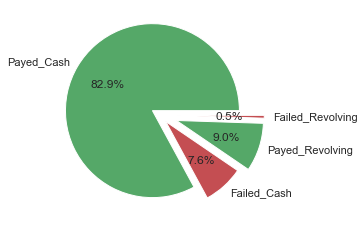

In [15]:
explodeList = (0.1, 0.1, 0.2, 0.2)
colorsList = ('g', 'r', 'g', 'r') 
plt.pie(application_count['count'],
        explode=explodeList,
        colors=colorsList,
        labels=application_count['case'],
        autopct='%1.1f%%')
plt.savefig("pie.png") 

## Contract types & Credits amounts

We check amounts & types from each of the 3 sources.

In [25]:
# case current application
# plot(application, "AMT_GOODS_PRICE", "NAME_CONTRACT_TYPE")

We'll deal later with outliers: application amount above a given threshold would surely require more attention by the company.


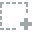
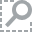
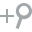
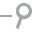
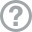
...
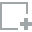
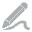
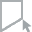
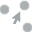
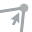

In [26]:
# case previous applications
plot(previous, 'NAME_CONTRACT_TYPE')

In [27]:
plot(previous, "AMT_GOODS_PRICE", 'NAME_CONTRACT_TYPE')

Previous applications let appear the 3rd contract type 'consumer loans' with smaller GOODS_PRICE: we would consider those loans as a subpart of Cash loans.


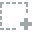
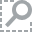
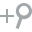
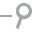
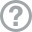
...
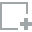
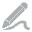
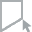
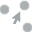
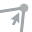

In [28]:
# case of external loans from "Credit Bureau"
plot(bureau, 'CREDIT_TYPE')

The largest value (Consumer credit) is over 3 times larger than the second largest value (Credit card)

Bureau applications let appear many other contract types, mainly due to the detailed purpose & context of the application. We should merge first to dig deeper, then eventually grouping relevant new types into application subset : basically we would consider only Credit Card as Revolving credits, and others as Cash + Consumer credits.

In [29]:
# clip by Mortgage upper whisker for box plot view
plot(bureau[bureau['AMT_CREDIT_SUM'] < 13248000], "AMT_CREDIT_SUM", 'CREDIT_TYPE')

In [30]:
# clip by Mortgage upper whisker for line chart view
plot(bureau[bureau['AMT_CREDIT_SUM'] < 2500000], "AMT_CREDIT_SUM", 'CREDIT_TYPE')

## Monthly balance

We go one level deeper with x_balance datasets, containing monthly balances of any credit.

[ProgressBar] ProgressBar takes additional 10%+ of the computation time, consider disable it by passing 'progress=False' to the plot function.



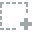
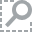
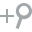
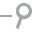
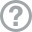
...
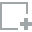
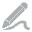
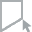
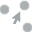
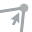

In [31]:
# monthly balance of the Bureau Credits
plot(bureau_balance['STATUS'])

Basically we get here to the complete story of external loans (well, considering X - unknow info for 21,28% of months balance) : <br/>
- C status measures the credit closing AGE in months (DAYS_ENDDATE_FACT in bureau), and any others gives the TERM,
- STATUS from 1-30 days (1) to over 120 days (5) provide the knowledge of clients failure and how deep considering the value of STATUS,
- Failure in early installments could be somehow accessible : the minimal month number where occurs a failure, i.e. with STATUS in [1, 5].

[ProgressBar] ProgressBar takes additional 10%+ of the computation time, consider disable it by passing 'progress=False' to the plot function.



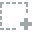
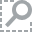
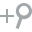
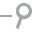
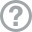
...
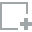
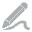
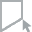
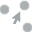
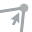

In [32]:
# same with credit balance
plot(credit_balance, 'NAME_CONTRACT_STATUS')

Opposite to Bureau credits, those contracts are mainly in an Active STATUS (not 'Completed' : closed), 'previous' will provide the right value.


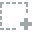
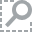
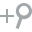
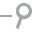
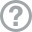
...
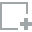
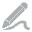
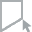
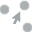
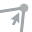

In [33]:
plot(credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0], 'NAME_CONTRACT_STATUS')

In [34]:
focus_credit = credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0]
focus_credit = focus_credit[focus_credit['NAME_CONTRACT_STATUS'] == 'Active']

In [35]:
focus_credit.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
7841423,1756934,400802,-30,12.0,0.0,Active,1486,0
3023093,1885018,386251,-93,4.0,0.0,Active,0,0
9736873,2356135,334139,-60,8.0,0.0,Active,1133,0


In [36]:
installments[installments['SK_ID_PREV'] == 1028739]

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
7752795,1028739,323522,1.0,7,-752.0,-781.0,12461.625,12461.625
7801709,1028739,323522,1.0,14,-542.0,-575.0,12461.625,12461.625
7886130,1028739,323522,2.0,17,-452.0,-452.0,24586.695,24586.695
7888388,1028739,323522,1.0,5,-812.0,-847.0,12461.625,12461.625
8010917,1028739,323522,1.0,12,-602.0,-639.0,12461.625,12461.625
8336320,1028739,323522,1.0,15,-512.0,-547.0,12461.625,12461.625
8421119,1028739,323522,1.0,2,-902.0,-939.0,12461.625,12461.625
8465473,1028739,323522,1.0,3,-872.0,-900.0,12461.625,12461.625
9256526,1028739,323522,1.0,1,-932.0,-954.0,12461.625,12461.625
9257828,1028739,323522,1.0,16,-482.0,-512.0,12461.625,12461.625


We got here the case of a contract closed by full payment before term. Let's see how 'previous' application table deal with it.

In [37]:
previous[previous['SK_ID_PREV'] == 1028739]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1407888,1028739,323522,Consumer loans,12461.625,190080.0,190080.0,0.0,190080.0,SATURDAY,16,Y,1,0.0,NaN,NaN,XAP,Approved,-965,Cash through the bank,XAP,Unaccompanied,Repeater,Consumer Electronics,POS,XNA,Stone,489,Consumer electronics,18.0,low_normal,POS household with interest,365243.0,-932.0,-422.0,-452.0,-434.0,0.0


Contracts could remain in Active STATUS while actualy Completed by anticipation.

In [38]:
# Credit and Card balance
print('failure ratio : ' + str(
    credit_balance[credit_balance['SK_DPD_DEF'] > 0].shape[0] / credit_balance.shape[0]))
credit_balance[credit_balance['SK_DPD_DEF'] > 0].sample(3)

failure ratio : 0.011395352511128989


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
3356026,2803923,150750,-16,24.0,11.0,Active,6,6
652129,1721188,225886,-77,10.0,2.0,Active,5,5
7606999,1898257,363772,-8,24.0,7.0,Active,2,2


SK_DPD & SK_DPD_DEF contains over 1,1% of monthly failure - with DPD in days and a "tolerance" is applied to build _DEF

In [39]:
installments[installments['SK_ID_PREV'] == 1723041]

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
3848747,1723041,251704,1.0,1,-591.0,-598.0,29129.805,29129.805
4051044,1723041,251704,1.0,5,-471.0,-449.0,29129.805,28760.310
4163108,1723041,251704,1.0,10,-321.0,-321.0,29129.805,29129.805
4310416,1723041,251704,1.0,9,-351.0,-357.0,29129.805,2143.845
4380647,1723041,251704,1.0,7,-411.0,-410.0,29129.805,205.200
4767441,1723041,251704,1.0,8,-381.0,-382.0,29129.805,29129.805
4823883,1723041,251704,4.0,11,-291.0,-300.0,288317.790,288317.790
4969288,1723041,251704,1.0,7,-411.0,-403.0,29129.805,28924.605
5003545,1723041,251704,1.0,9,-351.0,-349.0,29129.805,73.980
5047629,1723041,251704,1.0,5,-471.0,-480.0,29129.805,369.495


Here we observe smaller amounts explaining DPD, 

In [40]:
previous[previous['SK_ID_PREV'] == 1723041]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1199863,1723041,251704,Cash loans,29129.805,337500.0,368685.0,NaN,337500.0,TUESDAY,7,Y,1,NaN,NaN,NaN,Urgent needs,Approved,-623,XNA,XAP,NaN,Repeater,XNA,Cash,walk-in,AP+ (Cash loan),4,XNA,24.0,high,Cash Street: high,365243.0,-591.0,99.0,-291.0,-289.0,0.0


In [41]:
installments[installments['SK_ID_PREV'] == 1723041]

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
3848747,1723041,251704,1.0,1,-591.0,-598.0,29129.805,29129.805
4051044,1723041,251704,1.0,5,-471.0,-449.0,29129.805,28760.310
4163108,1723041,251704,1.0,10,-321.0,-321.0,29129.805,29129.805
4310416,1723041,251704,1.0,9,-351.0,-357.0,29129.805,2143.845
4380647,1723041,251704,1.0,7,-411.0,-410.0,29129.805,205.200
4767441,1723041,251704,1.0,8,-381.0,-382.0,29129.805,29129.805
4823883,1723041,251704,4.0,11,-291.0,-300.0,288317.790,288317.790
4969288,1723041,251704,1.0,7,-411.0,-403.0,29129.805,28924.605
5003545,1723041,251704,1.0,9,-351.0,-349.0,29129.805,73.980
5047629,1723041,251704,1.0,5,-471.0,-480.0,29129.805,369.495



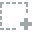
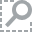
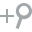
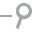
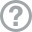
...
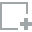
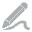
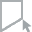
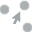
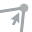

In [42]:
# same with card balance
plot(card_balance, 'NAME_CONTRACT_STATUS')

Again we observe an abnormal Active STATUS.

We won't ge deeper in that path, because we would rather get a similar info from both types of credits, and it represents too much additionnal effort to master this special credit card behavior.

## Bottom Up aggregation

In [12]:
print('installments :')
installments = convert_types(installments, print_info=True)

installments :
Original Memory Usage: 0.87 gb.
New Memory Usage: 0.49 gb.


In [62]:
print('bureau_balance :')
bureau_balance = convert_types(bureau_balance, print_info=True)
print('bureau :')
bureau = convert_types(bureau, print_info=True)

bureau_balance :
Original Memory Usage: 0.66 gb.
New Memory Usage: 0.35 gb.
bureau :
Original Memory Usage: 0.23 gb.
New Memory Usage: 0.13 gb.


In [16]:
print('previous :')
previous = convert_types(previous, print_info=True)
print('application :')
application = convert_types(application, print_info=True)
print('bureau_balance :')
bureau_balance = convert_types(bureau_balance, print_info=True)
print('bureau :')
bureau = convert_types(bureau, print_info=True)
print('credit_balance :')
credit_balance = convert_types(credit_balance, print_info=True)
print('card_balance :')
card_balance = convert_types(card_balance, print_info=True)
print('installments :')
installments = convert_types(installments, print_info=True)

previous :
Original Memory Usage: 0.49 gb.
New Memory Usage: 0.18 gb.
application :
Original Memory Usage: 0.3 gb.
New Memory Usage: 0.17 gb.
bureau_balance :
Original Memory Usage: 0.66 gb.
New Memory Usage: 0.35 gb.
bureau :
Original Memory Usage: 0.23 gb.
New Memory Usage: 0.13 gb.
credit_balance :
Original Memory Usage: 0.64 gb.
New Memory Usage: 0.41 gb.
card_balance :
Original Memory Usage: 0.71 gb.
New Memory Usage: 0.42 gb.
installments :
Original Memory Usage: 0.87 gb.
New Memory Usage: 0.49 gb.


### Aggregate over installments

While every payments are detailed over any previous application SK_ID_PREV, what matters for us, somehow already accessible through both credit balance or card balance with SK_DPD, is the rough info where (i.e. when and how much) a client failed to pay the installement.

In [13]:
installments.sample(3)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
706230,1938321,190071,1.0,7,-1392.0,-1413.0,10281.464844,10281.464844
6773685,2445275,249440,4.0,7,-119.0,-134.0,458957.156250,458957.156250
3309320,1783907,111184,1.0,2,-686.0,-687.0,21928.500000,21928.500000


In [14]:
# Missing values statistics
missing_values_table(installments)

Your selected dataframe has 8 columns.
There are 2 columns that have missing values.


,Missing Values,% of Total Values
DAYS_ENTRY_PAYMENT,2905,0.0
AMT_PAYMENT,2905,0.0


In [15]:
installments.dropna(inplace=True)

Let's catch overdue in time and amount :

In [77]:
# manual FE installements
# overdue amounts
installments['N_INS_AMT_OVERDUE'] = installments['AMT_INSTALMENT'] - installments['AMT_PAYMENT']
installments['N_INS_AMT_OVERDUE'] = installments['N_INS_AMT_OVERDUE'].apply(lambda x: x if x > 0 else 0)
# prepayed amounts
installments['N_INS_AMT_PREPAYED'] = installments['AMT_PAYMENT'] - installments['AMT_INSTALMENT']
installments['N_INS_AMT_PREPAYED'] = installments['N_INS_AMT_PREPAYED'].apply(lambda x: x if x > 0 else 0)
# overdue ratio
installments['N_AMT_OVERDUE_RATIO'] = installments['N_INS_AMT_OVERDUE'] / (1 + installments['AMT_INSTALMENT'])
# with positive values to get a match with SK_DPD
installments['N_INS_DPD'] = installments['DAYS_ENTRY_PAYMENT'] - installments['DAYS_INSTALMENT']
installments['N_INS_DPD'] = installments['N_INS_DPD'].apply(lambda x: x if x > 0 else 0)
# same with DBD Before Due may be somehow valuable
installments['N_INS_DBD'] = installments['DAYS_INSTALMENT'] - installments['DAYS_ENTRY_PAYMENT']
installments['N_INS_DBD'] = installments['N_INS_DBD'].apply(lambda x: x if x > 0 else 0)
# DPD categories to get a match with Bureau data
bins = [-np.inf, 1, 30, 60, 90, 120, np.inf]
values = ['0', '1', '2', '3', '4', '5']
installments['N_STATUS'] = pd.cut(installments['N_INS_DPD'], bins, labels=values)

In [78]:
# to get earliness of overdue we need to catch min of NUM_INSTALMENT_NUMBER out of !=0 N_STATUS
focus_installments = installments[installments['N_STATUS'] != '0']
focus_installments_agg = focus_installments.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'NUM_INSTALMENT_NUMBER': ['min']})
focus_installments_agg.columns = [
    'SK_ID_PREV',
    'N_PREV_EARLIER_OVERDUE']

The less this "earlier overdue" is, the more is the risk of failure. But from Null value point of view, we won't be able to set a right replacement value for clients with no overdue at all : let's first consider other aggregative data to compute a valid overdue earliness index.

In [79]:
# compute valuable features by SK_ID_PREV
installments_agg = installments.groupby(
    'SK_ID_PREV',
    as_index=False).agg(
    {'NUM_INSTALMENT_VERSION': ['max'],
     'N_INS_AMT_OVERDUE': ['max'],
     'NUM_INSTALMENT_NUMBER': ['max'],
     'DAYS_INSTALMENT': ['max']})
installments_agg.columns = [
    'SK_ID_PREV',
    'N_PREV_CNT_PROLONG',
    'N_PREV_INS_AMT_MAX_OVERDUE',
    'N_PREV_CNT_TOT_INSTALMENT',
    'N_PREV_LAST_DAYS_INSTALMENT']

In [80]:
# merge with raw earlier overdue
installments_agg = installments_agg.merge(focus_installments_agg, how='left', on='SK_ID_PREV')
# we compute a ratio with ability to fill Null with Zero after aggregation
installments_agg['N_PREV_EARLINESS_OVERDUE_RATIO'] = 1 - installments_agg['N_PREV_EARLIER_OVERDUE'] / installments_agg['N_PREV_CNT_TOT_INSTALMENT']
installments_agg.drop(columns=['N_PREV_EARLIER_OVERDUE'], inplace=True)
installments_agg['N_PREV_EARLINESS_OVERDUE_RATIO'].fillna(0, inplace=True)
installments_agg['N_PREV_LOAN_AGE'] = - installments_agg['N_PREV_LAST_DAYS_INSTALMENT'] / 365

In [82]:
installments_agg.columns

Index(['SK_ID_PREV', 'N_PREV_CNT_PROLONG', 'N_PREV_INS_AMT_MAX_OVERDUE',
       'N_PREV_CNT_TOT_INSTALMENT', 'N_PREV_LAST_DAYS_INSTALMENT',
       'N_PREV_EARLINESS_OVERDUE_RATIO', 'N_PREV_LOAN_AGE'],
      dtype='object')

In [105]:
installments['N_STATUS'] = installments['N_STATUS'].astype('object')

In [108]:
installments.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NUM_INSTALMENT_VERSION',
       'NUM_INSTALMENT_NUMBER', 'DAYS_INSTALMENT', 'DAYS_ENTRY_PAYMENT',
       'AMT_INSTALMENT', 'AMT_PAYMENT', 'N_INS_AMT_OVERDUE',
       'N_INS_AMT_PREPAYED', 'N_AMT_OVERDUE_RATIO', 'N_INS_DPD', 'N_INS_DBD',
       'N_STATUS'],
      dtype='object')

In [115]:
# Preprocess installments_payments.csv
def installments_payments(ins, num_rows = None, nan_as_category = True):
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['max', 'nunique'],
        'NUM_INSTALMENT_NUMBER': ['max'],
        'DAYS_INSTALMENT': ['max'],
        'N_INS_DPD': ['max', 'mean', 'sum'],
        'N_INS_DBD': ['max', 'mean', 'sum'],
        'N_INS_AMT_OVERDUE': ['max', 'mean', 'sum', 'var'],
        'N_INS_AMT_PREPAYED' : ['max', 'mean', 'sum', 'var'],
        'N_AMT_OVERDUE_RATIO': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INS_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

In [110]:
sk_id_installments = installments_payments(installments, num_rows=None)

In [114]:
sk_id_installments.columns

Index(['INSTAL_NUM_INSTALMENT_VERSION_MAX',
       'INSTAL_NUM_INSTALMENT_VERSION_NUNIQUE',
       'INSTAL_NUM_INSTALMENT_NUMBER_MAX', 'INSTAL_DAYS_INSTALMENT_MAX',
       'INSTAL_N_INS_DPD_MAX', 'INSTAL_N_INS_DPD_MEAN', 'INSTAL_N_INS_DPD_SUM',
       'INSTAL_N_INS_DBD_MAX', 'INSTAL_N_INS_DBD_MEAN', 'INSTAL_N_INS_DBD_SUM',
       'INSTAL_N_INS_AMT_OVERDUE_MAX', 'INSTAL_N_INS_AMT_OVERDUE_MEAN',
       'INSTAL_N_INS_AMT_OVERDUE_SUM', 'INSTAL_N_INS_AMT_OVERDUE_VAR',
       'INSTAL_N_INS_AMT_PREPAYED_MAX', 'INSTAL_N_INS_AMT_PREPAYED_MEAN',
       'INSTAL_N_INS_AMT_PREPAYED_SUM', 'INSTAL_N_INS_AMT_PREPAYED_VAR',
       'INSTAL_N_AMT_OVERDUE_RATIO_MAX', 'INSTAL_N_AMT_OVERDUE_RATIO_MEAN',
       'INSTAL_N_AMT_OVERDUE_RATIO_SUM', 'INSTAL_N_AMT_OVERDUE_RATIO_VAR',
       'INSTAL_AMT_INSTALMENT_MAX', 'INSTAL_AMT_INSTALMENT_MEAN',
       'INSTAL_AMT_INSTALMENT_SUM', 'INSTAL_AMT_PAYMENT_MIN',
       'INSTAL_AMT_PAYMENT_MAX', 'INSTAL_AMT_PAYMENT_MEAN',
       'INSTAL_AMT_PAYMENT_SUM', 'INSTAL_DAYS_

#### Aggregate to and from previous applications

In [ ]:
# merge loan data through previous - as a first aggregation step
previous = previous.merge(installments_agg, how='left', on='SK_ID_PREV')

Those installments aggregative data produce many missing values once merged with previous, with high correlation with other set of missing values. We'll have to check why those loan are not described within the installement details.

### Aggregate over Bureau & Bureau_balance

We compute info from bureau_balance

In [ ]:
# manual feature engineering for bureau_balance and bureau
'''
bureau.csv	N_CREDIT_OBS_WINDOW	= (DAYS_CREDIT - DAYS_CREDIT_UPDATE) / 30, time period in month where credit can be observed
bureau.csv	N_STATUS_X_RATIO	= STATUS_s_SUM / N_CREDIT_OBS_WINDOW
bureau.csv	N_CREDIT_PROLONG_RATIO	= (DAYS_ENDDATE_FACT - DAYS_CREDIT_ENDDATE) / (DAYS_CREDIT - DAYS_CREDIT_UPDATE)
bureau.csv	N_AMT_CREDIT_DEBT_RATE	= bureau['AMT_CREDIT_SUM_DEBT']/(1 + bureau['AMT_CREDIT_SUM']) (null division)
bureau.csv	N_CREDIT_CLOSING_AGE	agg from STATUS if Closed, the nb of C months. 
bureau.csv	N_EARLIER_OVERDUE	agg from STATUS : the minimal month value for STATUS in [1, 5]
'''

In [74]:
# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(bureau, bb, num_rows = None, nan_as_category = True):
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category) 
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    print(bb_aggregations)
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BUR_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

In [75]:
bureau = bureau_and_balance(bureau, bureau_balance, num_rows=None)
print("Bureau df shape:", bureau.shape)
bureau.head()

{'MONTHS_BALANCE': ['min', 'max', 'size'], 'STATUS_0': ['mean'], 'STATUS_1': ['mean'], 'STATUS_2': ['mean'], 'STATUS_3': ['mean'], 'STATUS_4': ['mean'], 'STATUS_5': ['mean'], 'STATUS_C': ['mean'], 'STATUS_X': ['mean'], 'STATUS_nan': ['mean']}
Bureau df shape: (305811, 116)


,BURO_DAYS_CREDIT_MIN,BURO_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_MEAN,BURO_DAYS_CREDIT_VAR,BURO_DAYS_CREDIT_ENDDATE_MIN,BURO_DAYS_CREDIT_ENDDATE_MAX,BURO_DAYS_CREDIT_ENDDATE_MEAN,BURO_DAYS_CREDIT_UPDATE_MEAN,BURO_CREDIT_DAY_OVERDUE_MAX,BURO_CREDIT_DAY_OVERDUE_MEAN,BURO_AMT_CREDIT_MAX_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_MAX,BURO_AMT_CREDIT_SUM_MEAN,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_DEBT_MAX,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_OVERDUE_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_MEAN,BURO_AMT_CREDIT_SUM_LIMIT_SUM,BURO_AMT_ANNUITY_MAX,BURO_AMT_ANNUITY_MEAN,BURO_CNT_CREDIT_PROLONG_SUM,BURO_MONTHS_BALANCE_MIN_MIN,BURO_MONTHS_BALANCE_MAX_MAX,BURO_MONTHS_BALANCE_SIZE_MEAN,BURO_MONTHS_BALANCE_SIZE_SUM,BURO_CREDIT_ACTIVE_Active_MEAN,BURO_CREDIT_ACTIVE_Bad debt_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_CREDIT_ACTIVE_Sold_MEAN,BURO_CREDIT_ACTIVE_nan_MEAN,BURO_CREDIT_CURRENCY_currency 1_MEAN,BURO_CREDIT_CURRENCY_currency 2_MEAN,BURO_CREDIT_CURRENCY_currency 3_MEAN,BURO_CREDIT_CURRENCY_currency 4_MEAN,BURO_CREDIT_CURRENCY_nan_MEAN,BURO_CREDIT_TYPE_Another type of loan_MEAN,BURO_CREDIT_TYPE_Car loan_MEAN,BURO_CREDIT_TYPE_Cash loan (non-earmarked)_MEAN,BURO_CREDIT_TYPE_Consumer credit_MEAN,BURO_CREDIT_TYPE_Credit card_MEAN,BURO_CREDIT_TYPE_Interbank credit_MEAN,BURO_CREDIT_TYPE_Loan for business development_MEAN,BURO_CREDIT_TYPE_Loan for purchase of shares (margin lending)_MEAN,BURO_CREDIT_TYPE_Loan for the purchase of equipment_MEAN,BURO_CREDIT_TYPE_Loan for working capital replenishment_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,BURO_CREDIT_TYPE_Mobile operator loan_MEAN,BURO_CREDIT_TYPE_Mortgage_MEAN,BURO_CREDIT_TYPE_Real estate loan_MEAN,BURO_CREDIT_TYPE_Unknown type of loan_MEAN,BURO_CREDIT_TYPE_nan_MEAN,BURO_STATUS_0_MEAN_MEAN,BURO_STATUS_1_MEAN_MEAN,BURO_STATUS_2_MEAN_MEAN,BURO_STATUS_3_MEAN_MEAN,BURO_STATUS_4_MEAN_MEAN,BURO_STATUS_5_MEAN_MEAN,BURO_STATUS_C_MEAN_MEAN,BURO_STATUS_X_MEAN_MEAN,BURO_STATUS_nan_MEAN_MEAN,ACTIVE_DAYS_CREDIT_MIN,ACTIVE_DAYS_CREDIT_MAX,ACTIVE_DAYS_CREDIT_MEAN,ACTIVE_DAYS_CREDIT_VAR,ACTIVE_DAYS_CREDIT_ENDDATE_MIN,ACTIVE_DAYS_CREDIT_ENDDATE_MAX,ACTIVE_DAYS_CREDIT_ENDDATE_MEAN,ACTIVE_DAYS_CREDIT_UPDATE_MEAN,ACTIVE_CREDIT_DAY_OVERDUE_MAX,ACTIVE_CREDIT_DAY_OVERDUE_MEAN,ACTIVE_AMT_CREDIT_MAX_OVERDUE_MEAN,ACTIVE_AMT_CREDIT_SUM_MAX,ACTIVE_AMT_CREDIT_SUM_MEAN,ACTIVE_AMT_CREDIT_SUM_SUM,ACTIVE_AMT_CREDIT_SUM_DEBT_MAX,ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN,ACTIVE_AMT_CREDIT_SUM_DEBT_SUM,ACTIVE_AMT_CREDIT_SUM_OVERDUE_MEAN,ACTIVE_AMT_CREDIT_SUM_LIMIT_MEAN,ACTIVE_AMT_CREDIT_SUM_LIMIT_SUM,ACTIVE_AMT_ANNUITY_MAX,ACTIVE_AMT_ANNUITY_MEAN,ACTIVE_CNT_CREDIT_PROLONG_SUM,ACTIVE_MONTHS_BALANCE_MIN_MIN,ACTIVE_MONTHS_BALANCE_MAX_MAX,ACTIVE_MONTHS_BALANCE_SIZE_MEAN,ACTIVE_MONTHS_BALANCE_SIZE_SUM,CLOSED_DAYS_CREDIT_MIN,CLOSED_DAYS_CREDIT_MAX,CLOSED_DAYS_CREDIT_MEAN,CLOSED_DAYS_CREDIT_VAR,CLOSED_DAYS_CREDIT_ENDDATE_MIN,CLOSED_DAYS_CREDIT_ENDDATE_MAX,CLOSED_DAYS_CREDIT_ENDDATE_MEAN,CLOSED_DAYS_CREDIT_UPDATE_MEAN,CLOSED_CREDIT_DAY_OVERDUE_MAX,CLOSED_CREDIT_DAY_OVERDUE_MEAN,CLOSED_AMT_CREDIT_MAX_OVERDUE_MEAN,CLOSED_AMT_CREDIT_SUM_MAX,CLOSED_AMT_CREDIT_SUM_MEAN,CLOSED_AMT_CREDIT_SUM_SUM,CLOSED_AMT_CREDIT_SUM_DEBT_MAX,CLOSED_AMT_CREDIT_SUM_DEBT_MEAN,CLOSED_AMT_CREDIT_SUM_DEBT_SUM,CLOSED_AMT_CREDIT_SUM_OVERDUE_MEAN,CLOSED_AMT_CREDIT_SUM_LIMIT_MEAN,CLOSED_AMT_CREDIT_SUM_LIMIT_SUM,CLOSED_AMT_ANNUITY_MAX,CLOSED_AMT_ANNUITY_MEAN,CLOSED_CNT_CREDIT_PROLONG_SUM,CLOSED_MONTHS_BALANCE_MIN_MIN,CLOSED_MONTHS_BALANCE_MAX_MAX,CLOSED_MONTHS_BALANCE_SIZE_MEAN,CLOSED_MONTHS_BALANCE_SIZE_SUM
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100001,-1572,-49,-735.000000,240043.666667,-1329.0,1778.0,82.428571,-93.142857,0,0.0,NaN,378000.0,207623.571429,1453365.000,373239.0,85240.928571,596686.5,0.0,0.00000,0.000,10822.5,3545.357143,0,-51.0,0.0,24.571429,172.0,0.428571,0.0,0.571429,0.0,0,1.0,0.0,0.0,0.0,0,0.0,0.0,0.0,1.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [ ]:
# drop closed status to compute valuable stats
n_bureau_balance = bureau_balance[bureau_balance['STATUS'] != 'C']

In [ ]:
restrain_bureau['N_AMT_CREDIT_DEBT_RATIO'] = restrain_bureau['AMT_CREDIT_SUM_DEBT'] / (1 + restrain_bureau['AMT_CREDIT_SUM'])

In [ ]:
plot(restrain_bureau, 'N_AMT_CREDIT_DEBT_RATIO')

In [ ]:
n_bureau_balance.shape[0] / bureau_balance.shape[0]

In [ ]:
# Counts of each type of status for each previous loan
n_bureau_balance_counts = count_categorical(n_bureau_balance, group_var = 'SK_ID_BUREAU', df_name = 'bureau_balance')

In [ ]:
n_bureau_balance_counts.sample(3)

In [ ]:
bureau_balance[bureau_balance['SK_ID_BUREAU'] == 5355895]

In [ ]:
bureau[bureau['SK_ID_BUREAU'] == 5355895]

### Previous applications

In [ ]:
credit_balance.sample(3)

In [ ]:
plot(credit_balance)

In [ ]:
credit_balance[credit_balance['SK_ID_PREV'] == 2506364]

In [ ]:
plot(previous, 'NAME_CONTRACT_STATUS')

In [ ]:
plot(previous[previous['NAME_CONTRACT_STATUS'] == 'Refused'], 'NAME_CLIENT_TYPE')

In [ ]:
plot(previous[previous['NAME_CONTRACT_TYPE'] == 'Revolving loans'], 'CHANNEL_TYPE')

In [ ]:
previous.sample(3)

In [ ]:
previous['PRODUCT_COMBINATION'].isnull().sum()

## Examine Missing Values

Next we can look at the number and percentage of missing values in each column. 


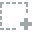
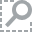
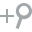
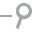
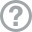
...
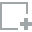
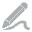
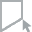
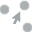
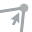

In [271]:
plot_missing(application)

In [ ]:
plot_missing(bureau)

In [ ]:
plot_missing(restrain_bureau[restrain_bureau['CREDIT_TYPE'] == 'Credit card'])

In [ ]:
plot_missing(restrain_bureau[restrain_bureau['CREDIT_TYPE'] == 'Consumer credit'])

In [ ]:
plot_missing(previous[previous['NAME_CONTRACT_STATUS'] == 'Approved'])

In [ ]:
for_inactive = previous[previous['NAME_CONTRACT_STATUS'] == 'Approved']

In [ ]:
for_inactive = for_inactive[for_inactive['DAYS_FIRST_DUE'].isnull()]

In [ ]:
plot(for_inactive, 'NAME_CONTRACT_TYPE')

In [ ]:
plot(for_inactive, 'CNT_PAYMENT')

In [ ]:
for_inactive.sample(3)

### Understanding missing values

As we will have to impute missing values, we should consider understanding why they are missing.

In [ ]:
plot(app_train, "TARGET", "OWN_CAR_AGE")

## Cleaning Application

In [ ]:
# application = app_train.copy()

In [79]:
application.describe()

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_WORK_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_AGE
count,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,252137.000000,307511.000000,307511.000000,104582.00000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,307511.000000
mean,278180.518577,0.417052,1.687391e+05,5.988308e+05,27110.958984,5.379796e+05,0.020867,-16036.995067,-2384.169325,-4986.019531,-2994.202373,12.06109,0.199368,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502134,5.144001e-01,0.510855,0.117432,0.088443,0.977784,0.752458,0.044621,0.078966,0.149782,0.226237,0.231908,0.066334,0.100775,0.107399,0.008808,0.028358,0.114242,0.087545,0.977106,0.759605,0.042553,0.074502,0.145251,0.222262,0.228073,0.064958,0.105649,0.105975,0.008078,0.027022,0.117838,0.087956,0.977799,0.755750,0.044595,0.078103,0.149272,0.225850,0.231641,0.067167,0.101955,0.108607,0.008653,0.028236,0.102546,1.422245,0.143421,1.405292,0.100049,-962.805725,0.000042,0.000081,0.01511

In [80]:
CNT_features = application.columns[application.columns.str.contains('DPD')]
CNT_features

Index([], dtype='object')

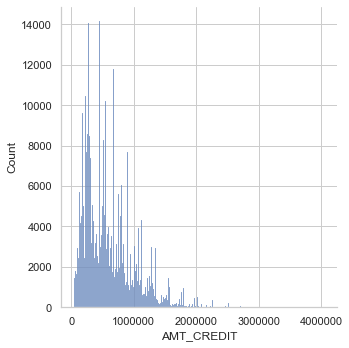

In [81]:
sns.displot(application['AMT_CREDIT'])

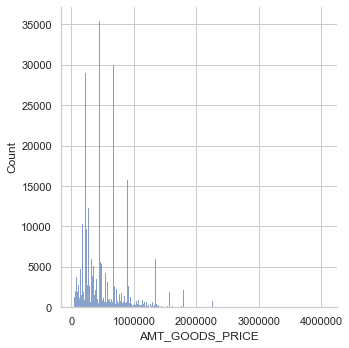

In [82]:
sns.displot(application['AMT_GOODS_PRICE'])

In [83]:
application['AMT_INSURANCE'] = application['AMT_CREDIT'] - application['AMT_GOODS_PRICE']

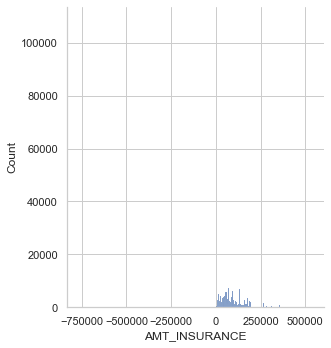

In [84]:
sns.displot(application['AMT_INSURANCE'])

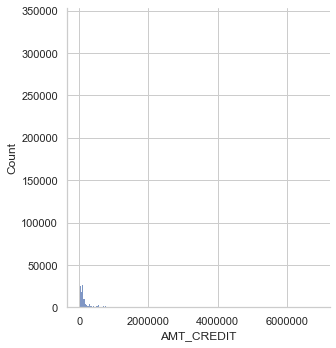

In [85]:
sns.displot(previous['AMT_CREDIT'])

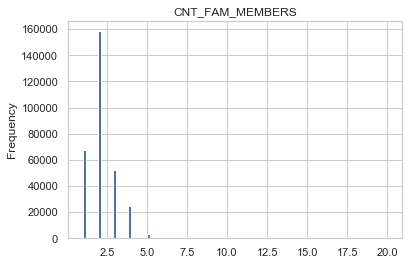

In [86]:
application['CNT_FAM_MEMBERS'].plot.hist(bins=100, title = 'CNT_FAM_MEMBERS');

In [87]:
col_desc[col_desc['Row'] == 'REGION_POPULATION_RELATIVE']['Description']

16    Normalized population of region where client lives (higher number means the client lives in more populated region)
Name: Description, dtype: object

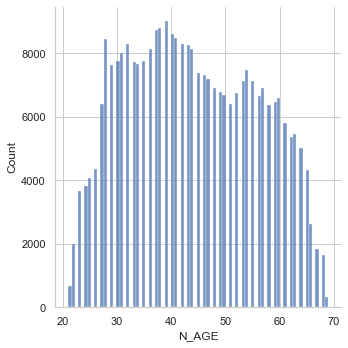

In [88]:
application['N_AGE'] = round(application['DAYS_BIRTH'] / -365)
sns.displot(application['N_AGE'])

Those ages look reasonable. There are no outliers for the age on either the high or low end. How about the days of employment? 

In [89]:
application['DAYS_EMPLOYED'].describe()

count    252137.000000
mean    -2384.169325  
std      2338.360162  
min     -17912.000000 
25%     -3175.000000  
50%     -1648.000000  
75%     -767.000000   
max      0.000000     
Name: DAYS_EMPLOYED, dtype: float64

That doesn't look right! The maximum value (besides being positive) is about 1000 years! 

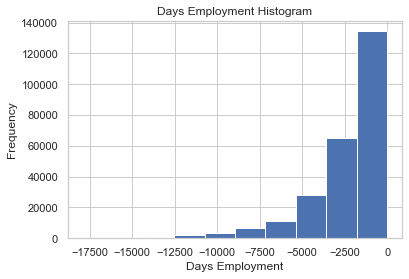

In [90]:
application['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

Just out of curiousity, let's subset the anomalous clients and see if they tend to have higher or low rates of default than the rest of the clients.

In [91]:
anom = application[application['DAYS_EMPLOYED'] == 365243]
non_anom = application[application['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.07% of loans
The anomalies default on nan% of loans
There are 0 anomalous days of employment


Well that is extremely interesting! It turns out that the anomalies have a lower rate of default. 

Handling the anomalies depends on the exact situation, with no set rules. One of the safest approaches is just to set the anomalies to a missing value and then have them filled in (using Imputation) before machine learning. In this case, since all the anomalies have the exact same value, we want to fill them in with the same value in case all of these loans share something in common. The anomalous values seem to have some importance, so we want to tell the machine learning model if we did in fact fill in these values. As a solution, we will fill in the anomalous values with not a number (`np.nan`) and then create a new boolean column indicating whether or not the value was anomalous.



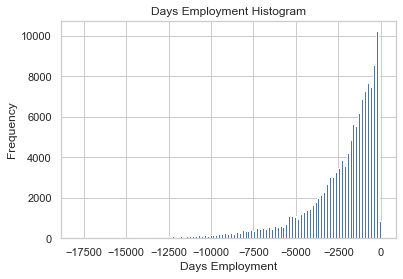

In [92]:
# Create an anomalous flag column
application['DAYS_EMPLOYED_ANOM'] = application["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
application['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

application['DAYS_EMPLOYED'].plot.hist(bins=200, title = 'Days Employment Histogram');
plt.xlabel('Days Employment');

The distribution looks to be much more in line with what we would expect, and we also have created a new column to tell the model that these values were originally anomalous (becuase we will have to fill in the nans with some value, probably the median of the column). The other columns with `DAYS` in the dataframe look to be about what we expect with no obvious outliers. 

As an extremely important note, anything we do to the training data we also have to do to the testing data. Let's make sure to create the new column and fill in the existing column with `np.nan` in the testing data.

In [93]:
'''
app_test['DAYS_EMPLOYED_ANOM'] = app_test["DAYS_EMPLOYED"] == 365243
app_test["DAYS_EMPLOYED"].replace({365243: np.nan}, inplace = True)

print('There are %d anomalies in the test data out of %d entries' % (app_test["DAYS_EMPLOYED_ANOM"].sum(), len(app_test)))
'''

'\napp_test[\'DAYS_EMPLOYED_ANOM\'] = app_test["DAYS_EMPLOYED"] == 365243\napp_test["DAYS_EMPLOYED"].replace({365243: np.nan}, inplace = True)\n\nprint(\'There are %d anomalies in the test data out of %d entries\' % (app_test["DAYS_EMPLOYED_ANOM"].sum(), len(app_test)))\n'

## Column Types

Let's look at the number of columns of each data type. `int64` and `float64` are numeric variables ([which can be either discrete or continuous](https://stats.stackexchange.com/questions/206/what-is-the-difference-between-discrete-data-and-continuous-data)). `object` columns contain strings and are  [categorical features.](http://support.minitab.com/en-us/minitab-express/1/help-and-how-to/modeling-statistics/regression/supporting-topics/basics/what-are-categorical-discrete-and-continuous-variables/) . 

In [94]:
# Number of each type of column
application.dtypes.value_counts()

float32     66
int64       33
bool        7 
category    2 
float64     2 
category    1 
category    1 
category    1 
int32       1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
category    1 
dtype: int64

Let's now look at the number of unique entries in each of the `object` (categorical) columns.

In [98]:
# Number of unique classes in each object column
application.select_dtypes('category').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE            2 
CODE_GENDER                   3 
FLAG_OWN_CAR                  2 
FLAG_OWN_REALTY               2 
NAME_TYPE_SUITE               7 
NAME_INCOME_TYPE              8 
NAME_EDUCATION_TYPE           5 
NAME_FAMILY_STATUS            6 
NAME_HOUSING_TYPE             6 
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START    7 
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE            4 
HOUSETYPE_MODE                3 
WALLSMATERIAL_MODE            7 
EMERGENCYSTATE_MODE           2 
dtype: int64

In [97]:
application['EMERGENCYSTATE_MODE'].value_counts()

No     159428
Yes    2328  
Name: EMERGENCYSTATE_MODE, dtype: int64

Most of the categorical variables have a relatively small number of unique entries. We will need to find a way to deal with these categorical variables! 

### Label Encoding and One-Hot Encoding

Let's implement the policy described above: for any categorical variable (`dtype == object`) with 2 unique categories, we will use label encoding, and for any categorical variable with more than 2 unique categories, we will use one-hot encoding. 

For label encoding, we use the Scikit-Learn `LabelEncoder` and for one-hot encoding, the pandas `get_dummies(df)` function.

In [101]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in application:
    if application[col].dtype == 'category':
        # If 2 or fewer unique categories
        if len(list(application[col].unique())) <= 2:
            # Train on the training data
            le.fit(application[col])
            # Transform both training and testing data
            application[col] = le.transform(application[col])
            # app_test[col] = le.transform(app_test[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

TypeError: data type 'category' not understood

In [102]:
# one-hot encoding of categorical variables
application = pd.get_dummies(application)
# app_test = pd.get_dummies(app_test)

print('Training Features shape: ', application.shape)
# print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 249)


### Aligning Training and Testing Data

There need to be the same features (columns) in both the training and testing data. One-hot encoding has created more columns in the training data because there were some categorical variables with categories not represented in the testing data. To remove the columns in the training data that are not in the testing data, we need to `align` the dataframes. First we extract the target column from the training data (because this is not in the testing data but we need to keep this information). When we do the align, we must make sure to set `axis = 1` to align the dataframes based on the columns and not on the rows!

In [103]:
# train_labels = app_train['TARGET']

# Align the training and testing data, keep only columns present in both dataframes
# app_train, app_test = app_train.align(app_test, join = 'inner', axis = 1)

# Add the target back in
# app_train['TARGET'] = train_labels

print('Training Features shape: ', application.shape)
# print('Testing Features shape: ', app_test.shape)

Training Features shape:  (307511, 249)


The training and testing datasets now have the same features which is required for machine learning. The number of features has grown significantly due to one-hot encoding. At some point we probably will want to try [dimensionality reduction (removing features that are not relevant)](https://en.wikipedia.org/wiki/Dimensionality_reduction) to reduce the size of the datasets.

### Correlations

Now that we have dealt with the categorical variables and the outliers, let's continue with the EDA. One way to try and understand the data is by looking for correlations between the features and the target. We can calculate the Pearson correlation coefficient between every variable and the target using the `.corr` dataframe method.

The correlation coefficient is not the greatest method to represent "relevance" of a feature, but it does give us an idea of possible relationships within the data. Some [general interpretations of the absolute value of the correlation coefficent](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf) are:


* .00-.19 “very weak”
*  .20-.39 “weak”
*  .40-.59 “moderate”
*  .60-.79 “strong”
* .80-1.0 “very strong”


In [104]:
# Find correlations with the target and sort
correlations = application.corr()['TARGET'].sort_values()

# Display correlations
print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
DAYS_EMPLOYED                                        0.074958
DAYS_BIRTH                                           0.078239
TARGET                                               1.000000
DAYS_EMPLOYED_ANOM                                  NaN      
Name: TARGET, dtype: float64

Most Negati

Let's take a look at some of more significant correlations: the `DAYS_BIRTH` is the most positive correlation. (except for `TARGET` because the correlation of a variable with itself is always 1!) Looking at the documentation, `DAYS_BIRTH` is the age in days of the client at the time of the loan in negative days (for whatever reason!). The correlation is positive, but the value of this feature is actually negative, meaning that as the client gets older, they are less likely to default on their loan (ie the target == 0). That's a little confusing, so we will take the absolute value of the feature and then the correlation will be negative.

### Effect of Age on Repayment

In [105]:
# Find the correlation of the positive days since birth and target
application['DAYS_BIRTH'] = abs(application['DAYS_BIRTH'])
application['DAYS_BIRTH'].corr(application['TARGET'])

-0.07823930830982709

As the client gets older, there is a negative linear relationship with the target meaning that as clients get older, they tend to repay their loans on time more often. 

Let's start looking at this variable. First, we can make a histogram of the age. We will put the x axis in years to make the plot a little more understandable.

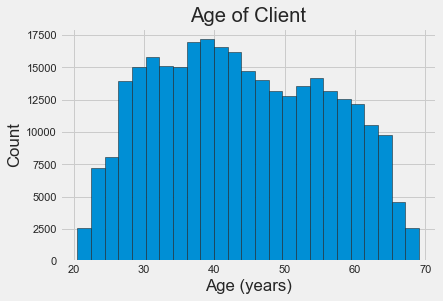

In [106]:
# Set the style of plots
plt.style.use('fivethirtyeight')

# Plot the distribution of ages in years
plt.hist(application['DAYS_BIRTH'] / 365, edgecolor = 'k', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

By itself, the distribution of age does not tell us much other than that there are no outliers as all the ages are reasonable. To visualize the effect of the age on the target, we will next make a [kernel density estimation plot](https://en.wikipedia.org/wiki/Kernel_density_estimation) (KDE) colored by the value of the target. A [kernel density estimate plot shows the distribution of a single variable](https://chemicalstatistician.wordpress.com/2013/06/09/exploratory-data-analysis-kernel-density-estimation-in-r-on-ozone-pollution-data-in-new-york-and-ozonopolis/) and can be thought of as a smoothed histogram (it is created by computing a kernel, usually a Gaussian, at each data point and then averaging all the individual kernels to develop a single smooth curve). We will use the seaborn `kdeplot` for this graph.

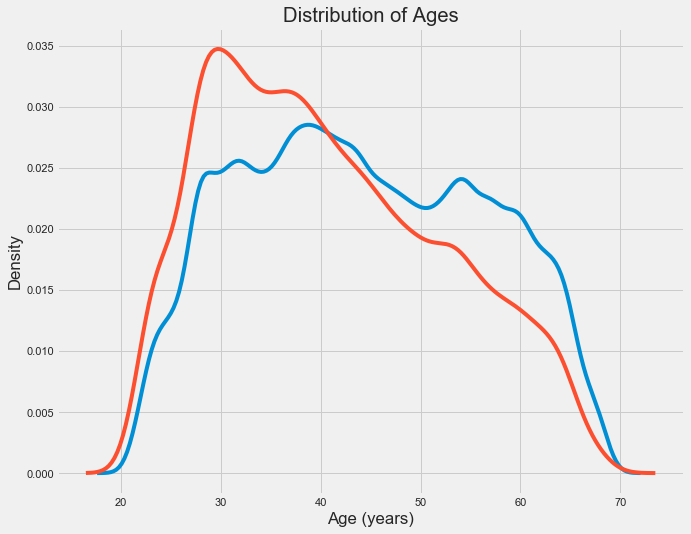

In [108]:
plt.figure(figsize = (10, 8))

# KDE plot of loans that were repaid on time
sns.kdeplot(application.loc[application['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'target == 0')

# KDE plot of loans which were not repaid on time
sns.kdeplot(application.loc[application['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'target == 1')

# Labeling of plot
plt.xlabel('Age (years)'); plt.ylabel('Density'); plt.title('Distribution of Ages');

The target == 1 curve skews towards the younger end of the range. Although this is not a significant correlation (-0.07 correlation coefficient), this variable is likely going to be useful in a machine learning model because it does affect the target. Let's look at this relationship in another way: average failure to repay loans by age bracket. 

To make this graph, first we `cut` the age category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age category.

In [109]:
# Age information into a separate dataframe
age_data = application[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,True,9461,25.920548,"(25.0, 30.0]"
1,False,16765,45.931507,"(45.0, 50.0]"
2,False,19046,52.180822,"(50.0, 55.0]"
3,False,19005,52.068493,"(50.0, 55.0]"
4,False,19932,54.608219,"(50.0, 55.0]"
5,False,16941,46.413699,"(45.0, 50.0]"
6,False,13778,37.747945,"(35.0, 40.0]"
7,False,18850,51.643836,"(50.0, 55.0]"
8,False,20099,55.065753,"(55.0, 60.0]"
9,False,14469,39.641096,"(35.0, 40.0]"


In [110]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


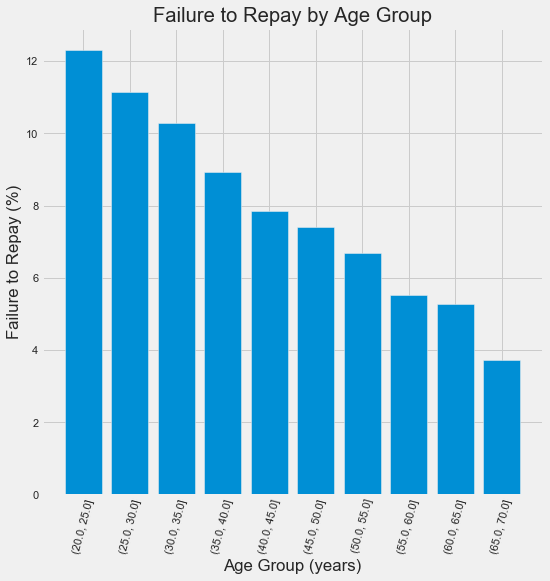

In [111]:
plt.figure(figsize = (8, 8))

# Graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'])

# Plot labeling
plt.xticks(rotation = 75); plt.xlabel('Age Group (years)'); plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group');

There is a clear trend: younger applicants are more likely to not repay the loan! The rate of failure to repay is above 10% for the youngest three age groups and beolow 5% for the oldest age group.

This is information that could be directly used by the bank: because younger clients are less likely to repay the loan, maybe they should be provided with more guidance or financial planning tips. This does not mean the bank should discriminate against younger clients, but it would be smart to take precautionary measures to help younger clients pay on time.

### Exterior Sources

The 3 variables with the strongest negative correlations with the target are `EXT_SOURCE_1`, `EXT_SOURCE_2`, and `EXT_SOURCE_3`.
According to the documentation, these features represent a "normalized score from external data source". I'm not sure what this exactly means, but it may be a cumulative sort of credit rating made using numerous sources of data. 

Let's take a look at these variables.

First, we can show the correlations of the `EXT_SOURCE` features with the target and with each other.

In [112]:
# Extract the EXT_SOURCE variables and show correlations
ext_data = application[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


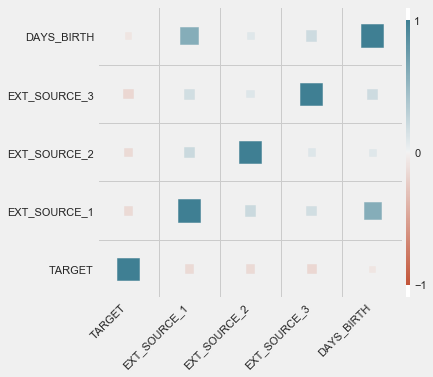

In [113]:
# calculer les corrélations entre features
corr = ext_data.corr(method='spearman')
corr = pd.melt(corr.reset_index(), id_vars='index')
corr.columns = ['x', 'y', 'value']
# visualiser les corrélations entre features
heatmap(
    x=corr['x'],
    y=corr['y'],
    size=corr['value'].abs(),
    color=corr['value']
)

All three `EXT_SOURCE` featureshave negative correlations with the target, indicating that as the value of the `EXT_SOURCE` increases, the client is more likely to repay the loan. We can also see that `DAYS_BIRTH` is positively correlated with `EXT_SOURCE_1` indicating that maybe one of the factors in this score is the client age.

Next we can look at the distribution of each of these features colored by the value of the target. This will let us visualize the effect of this variable on the target.

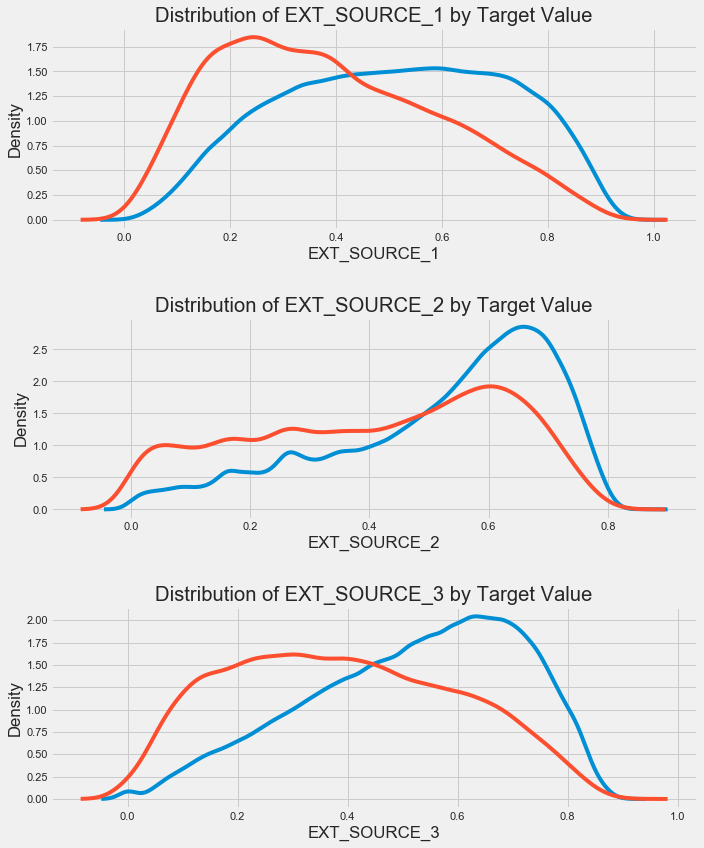

In [114]:
plt.figure(figsize = (10, 12))

# iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    
    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(application.loc[application['TARGET'] == 0, source], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(application.loc[application['TARGET'] == 1, source], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.xlabel('%s' % source); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)
    

`EXT_SOURCE_3` displays the greatest difference between the values of the target. We can clearly see that this feature has some relationship to the likelihood of an applicant to repay a loan. The relationship is not very strong (in fact they are all [considered very weak](http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf), but these variables will still be useful for a machine learning model to predict whether or not an applicant will repay a loan on time.

## Pairs Plot

As a final exploratory plot, we can make a pairs plot of the `EXT_SOURCE` variables and the `DAYS_BIRTH` variable. The [Pairs Plot](https://towardsdatascience.com/visualizing-data-with-pair-plots-in-python-f228cf529166) is a great exploration tool because it lets us see relationships between multiple pairs of variables as well as distributions of single variables. Here we are using the seaborn visualization library and the PairGrid function to create a Pairs Plot with scatterplots on the upper triangle, histograms on the diagonal, and 2D kernel density plots and correlation coefficients on the lower triangle.

If you don't understand this code, that's all right! Plotting in Python can be overly complex, and for anything beyond the simplest graphs, I usually find an existing implementation and adapt the code (don't repeat yourself)! 

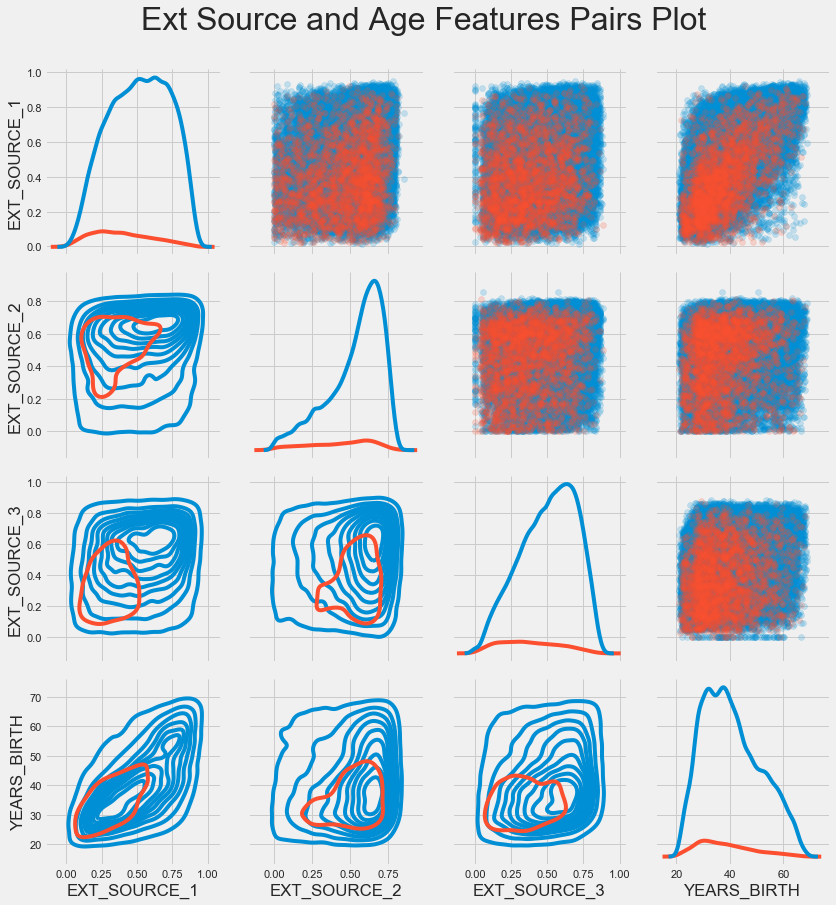

In [115]:
# Copy the data for plotting
plot_data = ext_data.drop(columns = ['DAYS_BIRTH']).copy()

# Add in the age of the client in years
plot_data['YEARS_BIRTH'] = age_data['YEARS_BIRTH']

# Drop na values and limit to first 100000 rows
plot_data = plot_data.dropna().loc[:100000, :]

# Function to calculate correlation coefficient between two columns
def corr_func(x, y, **kwargs):
    r = np.corrcoef(x, y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
                xy=(.2, .8), xycoords=ax.transAxes,
                size = 20)

# Create the pairgrid object
grid = sns.PairGrid(data = plot_data, size = 3, diag_sharey=False,
                    hue = 'TARGET', 
                    vars = [x for x in list(plot_data.columns) if x != 'TARGET'])

# Upper is a scatter plot
grid.map_upper(plt.scatter, alpha = 0.2)

# Diagonal is a histogram
grid.map_diag(sns.kdeplot)

# Bottom is density plot
grid.map_lower(sns.kdeplot, cmap = plt.cm.OrRd_r);

plt.suptitle('Ext Source and Age Features Pairs Plot', size = 32, y = 1.05);

In this plot, the red indicates loans that were not repaid and the blue are loans that are paid. We can see the different relationships within the data. There does appear to be a moderate positive linear relationship between the `EXT_SOURCE_1` and the `DAYS_BIRTH` (or equivalently `YEARS_BIRTH`), indicating that this feature may take into account the age of the client. 

# Feature Engineering

Kaggle competitions are won by feature engineering: those win are those who can create the most useful features out of the data. (This is true for the most part as the winning models, at least for structured data, all tend to be variants on [gradient boosting](http://blog.kaggle.com/2017/01/23/a-kaggle-master-explains-gradient-boosting/)). This represents one of the patterns in machine learning: feature engineering has a greater return on investment than model building and hyperparameter tuning. [This is a great article on the subject)](https://www.featurelabs.com/blog/secret-to-data-science-success/). As Andrew Ng is fond of saying: "applied machine learning is basically feature engineering." 

While choosing the right model and optimal settings are important, the model can only learn from the data it is given. Making sure this data is as relevant to the task as possible is the job of the data scientist (and maybe some [automated tools](https://docs.featuretools.com/getting_started/install.html) to help us out).

Feature engineering refers to a geneal process and can involve both feature construction: adding new features from the existing data, and feature selection: choosing only the most important features or other methods of dimensionality reduction. There are many techniques we can use to both create features and select features.

We will do a lot of feature engineering when we start using the other data sources, but in this notebook we will try only two simple feature construction methods: 

* Polynomial features => DEAD END
* Domain knowledge features


## Domain Knowledge Features

Maybe it's not entirely correct to call this "domain knowledge" because I'm not a credit expert, but perhaps we could call this "attempts at applying limited financial knowledge". In this frame of mind, we can make a couple features that attempt to capture what we think may be important for telling whether a client will default on a loan. Here I'm going to use five features that were inspired by [this script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) by Aguiar:

* `CREDIT_INCOME_PERCENT`: the percentage of the credit amount relative to a client's income
* `ANNUITY_INCOME_PERCENT`: the percentage of the loan annuity relative to a client's income
* `CREDIT_TERM`:  the length of the payment in months (since the annuity is the monthly amount due
* `DAYS_EMPLOYED_PERCENT`: the percentage of the days employed relative to the client's age

Again, thanks to Aguiar and [his great script](https://www.kaggle.com/jsaguiar/updated-0-792-lb-lightgbm-with-simple-features) for exploring these features.



In [116]:
app_train_domain = application.copy()
# app_test_domain = app_test.copy()

app_train_domain['CREDIT_INCOME_PERCENT'] = app_train_domain['AMT_CREDIT'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['ANNUITY_INCOME_PERCENT'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['CREDIT_TERM'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_CREDIT']
app_train_domain['DAYS_EMPLOYED_PERCENT'] = app_train_domain['DAYS_EMPLOYED'] / app_train_domain['DAYS_BIRTH']

In [117]:
'''
app_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']
app_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']
app_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']
'''

"\napp_test_domain['CREDIT_INCOME_PERCENT'] = app_test_domain['AMT_CREDIT'] / app_test_domain['AMT_INCOME_TOTAL']\napp_test_domain['ANNUITY_INCOME_PERCENT'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_INCOME_TOTAL']\napp_test_domain['CREDIT_TERM'] = app_test_domain['AMT_ANNUITY'] / app_test_domain['AMT_CREDIT']\napp_test_domain['DAYS_EMPLOYED_PERCENT'] = app_test_domain['DAYS_EMPLOYED'] / app_test_domain['DAYS_BIRTH']\n"

#### Visualize New Variables

We should explore these __domain knowledge__ variables visually in a graph. For all of these, we will make the same KDE plot colored by the value of the `TARGET`.

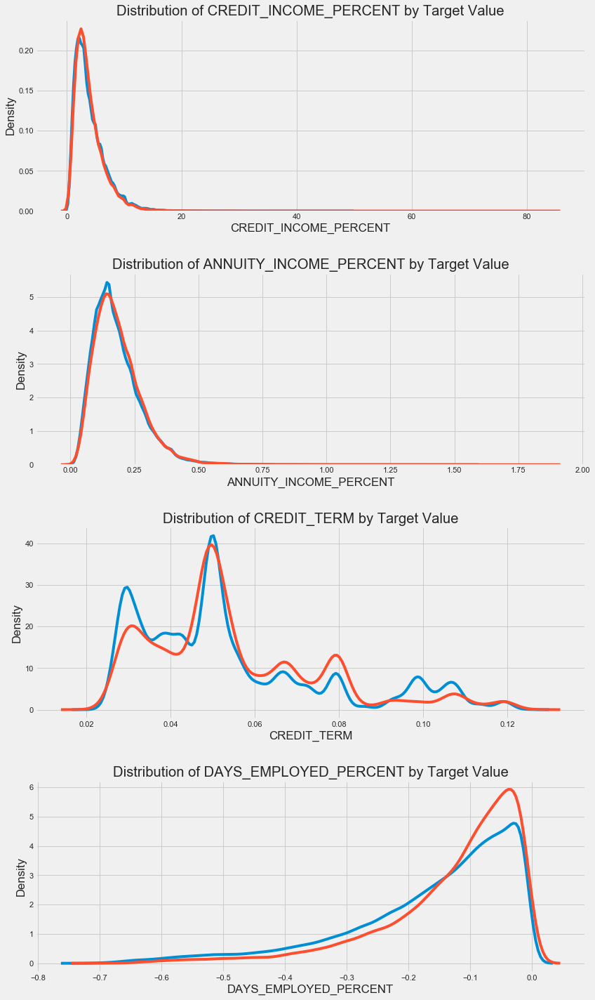

In [118]:
plt.figure(figsize = (12, 20))
# iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    
    # create a new subplot for each source
    plt.subplot(4, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 0, feature], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 1, feature], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature); plt.ylabel('Density');
    
plt.tight_layout(h_pad = 2.5)

It's hard to say ahead of time if these new features will be useful. The only way to tell for sure is to try them out! 

# Data preparation

## Train, Test split

We should not only remove Target in Test split, but also remove the SK_ID_CURR column (and move to index?)

In [219]:


def my_split(data=application, split_size=0.3):
    # drop the target from the training data
    if 'TARGET' in data:
        X_ = data.drop(columns = ['TARGET'])
    else:
        X_ = data.copy()
    y_ = data['TARGET']
    # Feature names
    features = list(X_.columns)
    # Median imputation of missing values
    imputer = SimpleImputer(missing_values=np.nan, strategy='median')
    # Scale each feature to 0-1
    scaler = MinMaxScaler(feature_range = (0, 1))
    # Fit-transform training dataset
    X_ = imputer.fit_transform(X_)
    # Repeat with the scaler
    X_ = scaler.fit_transform(X_)
    # Split data into train and test set (stratify by target)
    X_train, X_test, y_train, y_test = train_test_split(X_, y_, stratify=y_, test_size=split_size, random_state=42)
    print('Training data shape: ', X_train.shape)
    print('Testing data shape: ', X_test.shape)
    print('Labels train data shape: ', y_train.shape)
    print('Labels test data shape: ', y_test.shape)
    return X_train, X_test, y_train, y_test

In [218]:
my_split()

Training data shape:  (215257, 248)
Testing data shape:  (92254, 248)
Labels train data shape:  (215257,)
Labels test data shape:  (92254,)


## Results

First functions is meant to be used with arguments model & root application dataset

In [236]:


def split_show_results(model, data=application, split_size=0.3):
    X_train, X_test, y_train, y_test = my_split(data=data, split_size=split_size)
    model.fit(X_train, y_train)
    results = model.predict_proba(X_test)[:, 1]
    
    print('Auc Score: %f' %roc_auc_score(y_test, results))
    plot_roc_curve(model, X_test, y_test)
    plt.title(str(model) + 'Roc curve')
    plt.show()    

In [256]:


def show_results(model, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test, case='case'):
    model.fit(X_train, y_train)
    results = model.predict_proba(X_test)[:, 1]
    plt.title('Failure probabilities for '  + case)
    plt.xlabel('Probabilities')
    plt.ylabel('Count')
    plt.hist(results, bins=100)
    plt.show()
    # print('Auc Score: %f' %roc_auc_score(y_test, results))
    plot_roc_curve(model, X_test, y_test)
    plt.title('Roc curve of ' + case)
    plt.show()

# Baseline

For a naive baseline, we could guess the same value for all examples on the testing set.  We are asked to predict the probability of not repaying the loan, so if we are entirely unsure, we would guess 0.5 for all observations on the test set. This  will get us a Reciever Operating Characteristic Area Under the Curve (AUC ROC) of 0.5 in the competition ([random guessing on a classification task will score a 0.5](https://stats.stackexchange.com/questions/266387/can-auc-roc-be-between-0-0-5)).

Since we already know what score we are going to get, we don't really need to make a naive baseline guess. Let's use a slightly more sophisticated model for our actual baseline: Logistic Regression.

## Logistic Regression Implementation

Here I will focus on implementing the model rather than explaining the details, but for those who want to learn more about the theory of machine learning algorithms, I recommend both [An Introduction to Statistical Learning](http://www-bcf.usc.edu/~gareth/ISL/) and [Hands-On Machine Learning with Scikit-Learn and TensorFlow](http://shop.oreilly.com/product/0636920052289.do). Both of these books present the theory and also the code needed to make the models (in R and Python respectively). They both teach with the mindset that the best way to learn is by doing, and they are very effective! 

To get a baseline, we will use all of the features after encoding the categorical variables. We will preprocess the data by filling in the missing values (imputation) and normalizing the range of the features (feature scaling). The following code performs both of these preprocessing steps.

We will use [`LogisticRegression`from Scikit-Learn](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html) for our first model. The only change we will make from the default model settings is to lower the [regularization parameter](http://scikit-learn.org/stable/modules/linear_model.html#logistic-regression), C, which controls the amount of overfitting (a lower value should decrease overfitting). This will get us slightly better results than the default `LogisticRegression`, but it still will set a low bar for any future models.

Here we use the familiar Scikit-Learn modeling syntax: we first create the model, then we train the model using `.fit` and then we make predictions on the testing data using `.predict_proba` (remember that we want probabilities and not a 0 or 1).

In [224]:
# Make the model with the specified regularization parameter
log_reg = LogisticRegression(C=0.0001)

# Train on the training data
log_reg.fit(X_train, y_train)

LogisticRegression(C=0.0001)

Now that the model has been trained, we can use it to make predictions. We want to predict the probabilities of not paying a loan, so we use the model `predict.proba` method. This returns an m x 2 array where m is the number of observations. The first column is the probability of the target being 0 and the second column is the probability of the target being 1 (so for a single row, the two columns must sum to 1). We want the probability the loan is not repaid, so we will select the second column.

The following code makes the predictions and selects the correct column.

### raw prediction

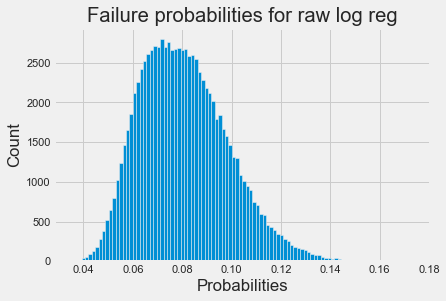

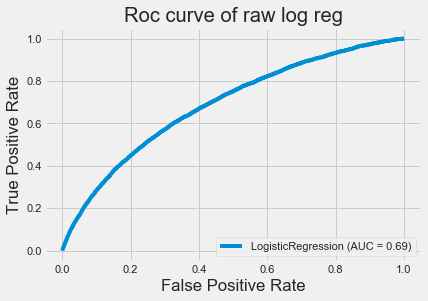

In [257]:
show_results(log_reg, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test, case='raw log reg')

### raw with class weight

In [259]:
# Make the model with the specified regularization parameter
log_reg_weight = LogisticRegression(class_weight='balanced', C=0.0001)

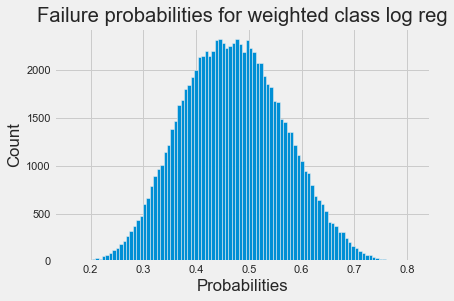

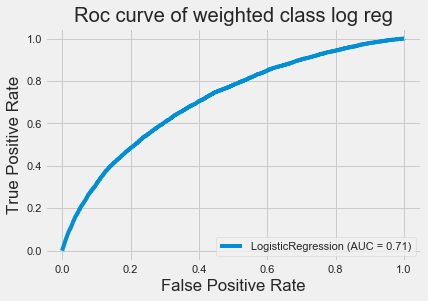

In [261]:
show_results(log_reg_weight, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test, case='weighted class log reg')

## SMOTE

In [266]:
sm = SMOTE(random_state = 7)

In [267]:
X_train_new, y_train_new = sm.fit_sample(X_train, y_train.ravel())

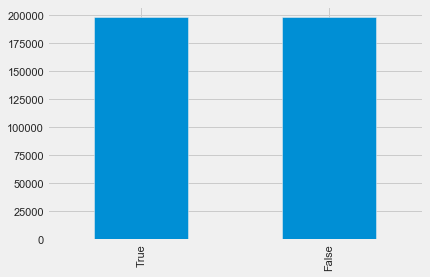

In [268]:
# observe that data has been balanced
pd.Series(y_train_new).value_counts().plot.bar()

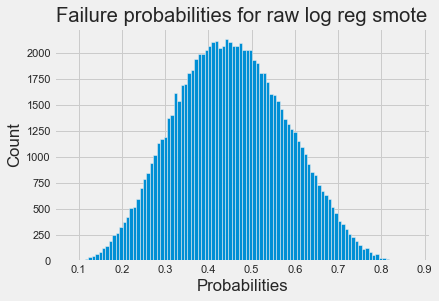

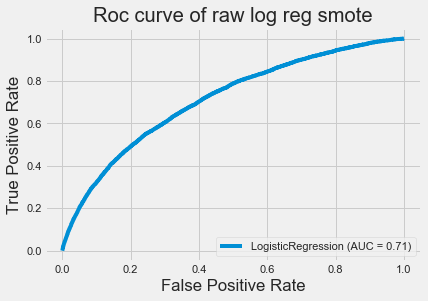

In [269]:
show_results(log_reg, X_train=X_train_new, X_test=X_test, y_train=y_train_new, y_test=y_test, case='raw log reg smote')

### introduce threshold

In [129]:
# define a function to make threshold adjustable
def threshold_pred(model, X, threshold=0.1):
    pred = model.predict_proba(X)
    y_pred = pred[:, 1] > threshold
    return y_pred.astype(int)

In [133]:
y_pred = threshold_pred(log_reg, X_test, threshold=0.1)

In [134]:
y_pred

array([0, 0, 0, ..., 0, 0, 0])

__Logistic Regression with Basic FE and Application df only score around AUC 0.69__

## Improved Model: Random Forest

To try and beat the poor performance of our baseline, we can update the algorithm. Let's try using a Random Forest on the same training data to see how that affects performance. The Random Forest is a much more powerful model especially when we use hundreds of trees. We will use 100 trees in the random forest.

In [262]:
# Make the random forest classifier
random_forest = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   34.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.3min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.5s finished


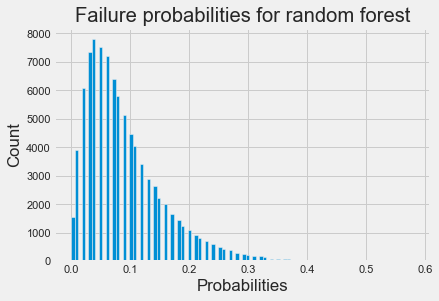

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


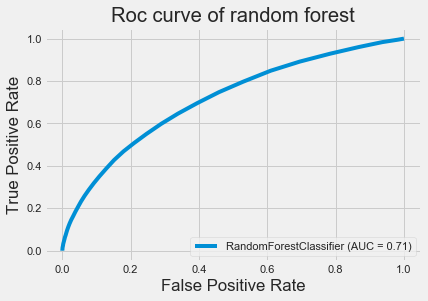

In [263]:
show_results(random_forest, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test, case='random forest')

In [138]:
# Train on the training data
random_forest.fit(X_train, y_train)

# Extract feature importances
feature_importance_values = random_forest.feature_importances_
feature_importances = pd.DataFrame({'feature': features, 'importance': feature_importance_values})

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   32.7s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.3min finished


In [264]:
# Make the random forest classifier
random_forest_weight = RandomForestClassifier(n_estimators = 100, class_weight='balanced', random_state = 50, verbose = 1, n_jobs = -1)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   28.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.0min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


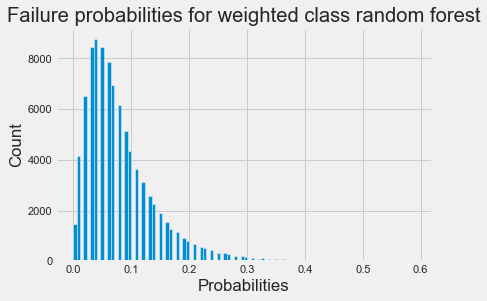

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


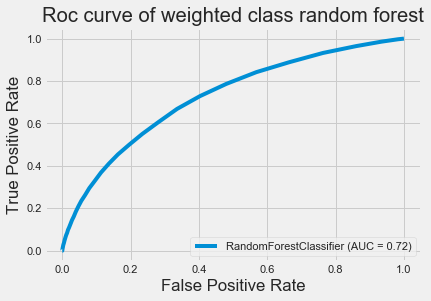

In [265]:
show_results(random_forest_weight, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test, case='weighted class random forest')

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.3min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.6s finished


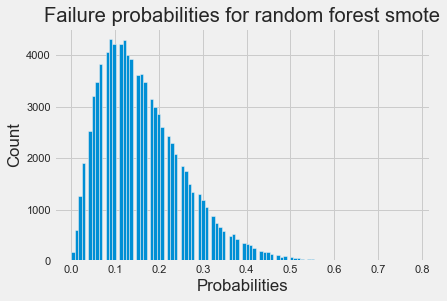

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.4s finished


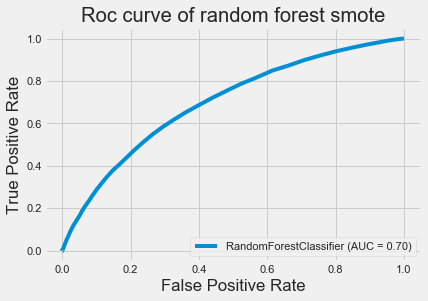

In [270]:
show_results(random_forest, X_train=X_train_new, X_test=X_test, y_train=y_train_new, y_test=y_test, case='random forest smote')

# SCORING

first, we need to avoid __False Negative__ : approval of any clients with actual defaults is our worts case, predicting target 0 while actual value is 1.
then, we also wish to avoid __False Positive__ : rejecting too many clients who actually would not fail, predicting target 1 while actual value is 0.

In [167]:
# get any case of the confusion matrix
# ravel() is equivalent to flatten for arrays
(tn, fp, fn, tp) = confusion_matrix(y_test, rf_y_pred).ravel()

In [168]:
# optimal threshold

list_tn = []
list_fp = []
list_fn = []
list_tp = []
threshold_values =[]

for i in np.arange(0,1,0.05) :
    temp_y_pred = threshold_pred(random_forest, X_test, threshold=i)
    tn, fp, fn, tp = confusion_matrix(y_test, temp_y_pred).ravel()
    print(tn, fp, fn, tp)
    list_tn.append(tn)
    list_fp.append(fp)
    list_fn.append(fn)
    list_tp.append(tp)
    threshold_values.append(i)

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


1527 83279 38 7410


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


33099 51707 1128 6320


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


60224 24582 2990 4458


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


73879 10927 4561 2887


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


80165 4641 5722 1726


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


82988 1818 6493 955


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


84145 661 6975 473


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


84591 215 7226 222


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


84747 59 7358 90


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


84793 13 7423 25


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


84806 0 7442 6


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.5s finished


84806 0 7447 1


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


84806 0 7448 0


In [169]:
confusion_matrix_df = pd.DataFrame({'tn' : list_tn,
                                    'fp' : list_fp,
                                    'fn' : list_fn,
                                    'tp' : list_tp},
                                   index=threshold_values)

In [170]:
rates = confusion_matrix_df.divide(confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']]

In [171]:
tot_rate = confusion_matrix_df.divide(confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']].sum(axis=1)

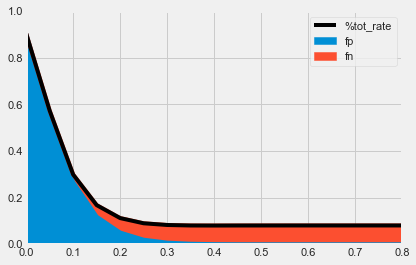

In [172]:
fig, ax = plt.subplots()
rates.plot(kind='area', stacked=True, ax=ax)
tot_rate.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

We have to find the right balance (cost) between both case to catch an optimal threshold : fn is n times worst than fp. as it primarily depends on the famous {X, Y} parameters, leading to a damage we have no clue to compute, we don't know real value of n. <br/>
n would surely be different for revolving or high amount credits. <br/>
let's start with 7, just to see the resulting shape of a damage value.

In [173]:
damage_df = pd.DataFrame({'fp damages : unit' : confusion_matrix_df['fp'],
                          'fn damages : 7x unit' : 7 * confusion_matrix_df['fn']})

In [174]:
damages = (damage_df/damage_df.sum(axis=1).max())

In [175]:
tot_damage = (damage_df.sum(axis=1)/damage_df.sum(axis=1).max())

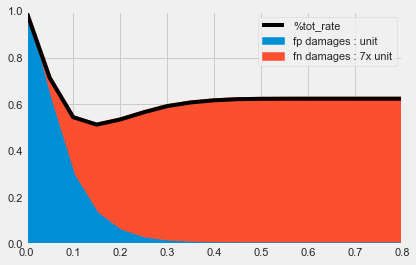

In [176]:
fig, ax = plt.subplots()
damages.plot(kind='area', stacked=True, ax=ax)
tot_damage.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

In [177]:
# refine optimal threshold

list_tn = []
list_fp = []
list_fn = []
list_tp = []
threshold_values =[]

for i in np.arange(0,0.2,0.01) :
    temp_y_pred = threshold_pred(random_forest, X_test, threshold=i)
    tn, fp, fn, tp = confusion_matrix(y_test, temp_y_pred).ravel()
    print(tn, fp, fn, tp)
    list_tn.append(tn)
    list_fp.append(fp)
    list_fn.append(fn)
    list_tp.append(tp)
    threshold_values.append(i)

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


1527 83279 38 7410


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


5353 79453 122 7326


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


11261 73545 297 7151


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


18368 66438 531 6917


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


25890 58916 808 6640


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


33099 51707 1128 6320


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


39921 44885 1513 5935


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


45935 38871 1881 5567


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


51347 33459 2268 5180


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


56106 28700 2635 4813


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


60224 24582 2990 4458


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


63915 20891 3347 4101


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


66996 17810 3668 3780


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


69604 15202 3959 3489


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


71939 12867 4263 3185


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.3s finished


73879 10927 4561 2887


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


75599 9207 4838 2610


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


77010 7796 5082 2366


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.4s finished


78242 6564 5313 2135


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.0s finished


79261 5545 5519 1929


In [178]:
adj_confusion_matrix_df = pd.DataFrame({'tn' : list_tn,
                                        'fp' : list_fp,
                                        'fn' : list_fn,
                                        'tp' : list_tp},
                                        index=threshold_values) 

In [179]:
adj_rates = adj_confusion_matrix_df.divide(adj_confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']]
adj_tot_rate = adj_confusion_matrix_df.divide(adj_confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']].sum(axis=1)

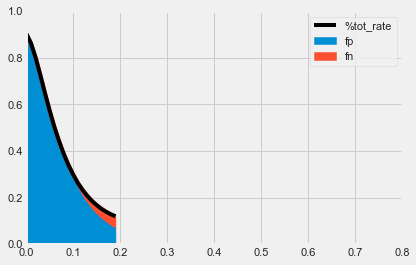

In [180]:
fig, ax = plt.subplots()
adj_rates.plot(kind='area', stacked=True, ax=ax)
adj_tot_rate.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

In [181]:
adj_damage_df = pd.DataFrame({'fp damages : unit' : adj_confusion_matrix_df['fp'],
                              'fn damages : 7x unit' : 7 * adj_confusion_matrix_df['fn']})

adj_damages = (adj_damage_df/adj_damage_df.sum(axis=1).max())

adj_tot_damage = (adj_damage_df.sum(axis=1)/adj_damage_df.sum(axis=1).max())

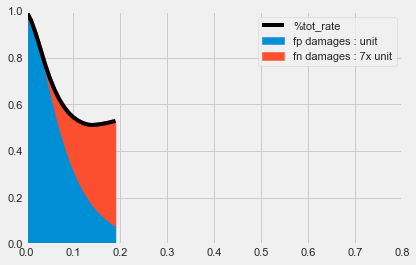

In [182]:
fig, ax = plt.subplots()
adj_damages.plot(kind='area', stacked=True, ax=ax)
adj_tot_damage.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

In [183]:
# optimal threshold
adj_damage_df.sum(axis=1).idxmin()

0.14

#### Same with class_weight

In [186]:
random_forest_weight.predict_proba(X_test)[:, 1]

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


array([0.08, 0.07, 0.06, ..., 0.06, 0.03, 0.08])

In [187]:
# optimal threshold

list_tn = []
list_fp = []
list_fn = []
list_tp = []
threshold_values =[]

for i in np.arange(0,1,0.05) :
    temp_y_pred = threshold_pred(random_forest_weight, X_test, threshold=i)
    tn, fp, fn, tp = confusion_matrix(y_test, temp_y_pred).ravel()
    print(tn, fp, fn, tp)
    list_tn.append(tn)
    list_fp.append(fp)
    list_fn.append(fn)
    list_tp.append(tp)
    threshold_values.append(i)

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


1450 83356 22 7426


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


36633 48173 1177 6271


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


64943 19863 3347 4101


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


76787 8019 5005 2443


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.2s finished


81451 3355 6078 1370


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


83388 1418 6717 731


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.9s finished


84219 587 7075 373


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


84565 241 7255 193


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


84717 89 7361 87


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


84771 35 7411 37


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


84797 9 7431 17


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.8s finished


84804 2 7444 4


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.6s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.6s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    1.7s finished


84806 0 7448 0


In [188]:
confusion_matrix_df = pd.DataFrame({'tn' : list_tn,
                                    'fp' : list_fp,
                                    'fn' : list_fn,
                                    'tp' : list_tp},
                                   index=threshold_values)

In [189]:
rates = confusion_matrix_df.divide(confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']]

In [190]:
tot_rate = confusion_matrix_df.divide(confusion_matrix_df.sum(axis=1), axis=0)[['fp', 'fn']].sum(axis=1)

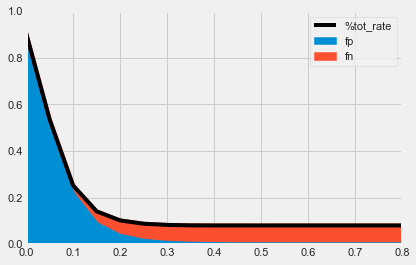

In [191]:
fig, ax = plt.subplots()
rates.plot(kind='area', stacked=True, ax=ax)
tot_rate.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

We have to find the right balance (cost) between both case to catch an optimal threshold : fn is n times worst than fp. as it primarily depends on the famous {X, Y} parameters, leading to a damage we have no clue to compute, we don't know real value of n. <br/>
n would surely be different for revolving or high amount credits. <br/>
let's start with 7, just to see the resulting shape of a damage value.

In [192]:
damage_df = pd.DataFrame({'fp damages : unit' : confusion_matrix_df['fp'],
                          'fn damages : 7x unit' : 7 * confusion_matrix_df['fn']})

In [193]:
damages = (damage_df/damage_df.sum(axis=1).max())

In [194]:
tot_damage = (damage_df.sum(axis=1)/damage_df.sum(axis=1).max())

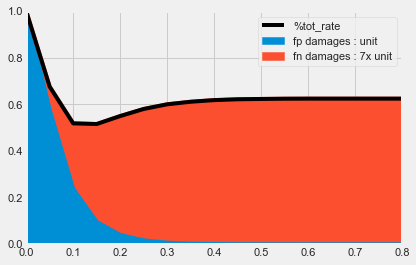

In [195]:
fig, ax = plt.subplots()
damages.plot(kind='area', stacked=True, ax=ax)
tot_damage.plot(ax=ax, color="black", label="%tot_rate")
ax.set_xlim(0,0.8)
ax.set_ylim(0,1)
ax.legend()
plt.show()

#### Testing Domain Features

Now we can test the domain features we made by hand.

In [ ]:
# same with so called "domain" features
if 'TARGET' in app_train:
    X_domain = app_train_domain.drop(columns = ['TARGET'])
else:
    X_domain = app_train_domain.copy()
y_domain = app_train_domain['TARGET']
    
# Feature names
domain_features_names = list(X_domain.columns)


# Median imputation of missing values
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

# Scale each feature to 0-1
scaler = MinMaxScaler(feature_range = (0, 1))

# Fit-transform training dataset
X_domain = imputer.fit_transform(X_domain)

# Repeat with the scaler
X_domain = scaler.fit_transform(X_domain)

# Split data into train and test set (stratify by target)
X_dom_train, X_dom_test, y_dom_train, y_dom_test = train_test_split(X_domain, y_domain, stratify=y_domain, test_size=0.3, random_state=42)


print('Training data shape: ', X_dom_train.shape)
print('Testing data shape: ', X_dom_test.shape)

print('Labels train data shape: ', y_dom_train.shape)
print('Labels test data shape: ', y_dom_test.shape)

In [ ]:
# Make the random forest classifier
random_forest_domain = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [ ]:
# Train on the training data
random_forest_domain.fit(X_dom_train, y_dom_train)

# Extract feature importances
feature_importance_domain_values = random_forest_domain.feature_importances_
feature_importances_domain = pd.DataFrame({'feature': domain_features_names, 'importance': feature_importance_domain_values})

# Make predictions on the test data
ran_for_dom_pred = random_forest_domain.predict_proba(X_dom_test)[:, 1]

__Random Forest with Basic FE and Application df only score around AUC 0.71__

#### Testing transparency 

Now we can test the removal of ext_ features as well as SK ID

In [ ]:
# same with so called "domain" features
app_transp = app_train_domain.drop(columns = ['SK_ID_CURR', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3'])


if 'TARGET' in app_train:
    X_transp = app_transp.drop(columns = ['TARGET'])
else:
    X_transp = app_transp.copy()
y_transp = app_transp['TARGET']
    
# Feature names
transp_features_names = list(X_transp.columns)


# Median imputation of missing values
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

# Scale each feature to 0-1
scaler = MinMaxScaler(feature_range = (0, 1))

# Fit-transform training dataset
X_transp = imputer.fit_transform(X_transp)

# Repeat with the scaler
X_transp = scaler.fit_transform(X_transp)

# Split data into train and test set (stratify by target)
X_transp_train, X_transp_test, y_transp_train, y_transp_test = train_test_split(X_transp, y_transp, stratify=y_transp, test_size=0.3, random_state=42)


print('Training data shape: ', X_transp_train.shape)
print('Testing data shape: ', X_transp_test.shape)

print('Labels train data shape: ', y_transp_train.shape)
print('Labels test data shape: ', y_transp_test.shape)

In [ ]:
# Make the random forest classifier
random_forest_transp = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [ ]:
# Train on the training data
random_forest_transp.fit(X_transp_train, y_transp_train)

# Extract feature importances
feature_importance_transp_values = random_forest_transp.feature_importances_
feature_importances_transp = pd.DataFrame({'feature': transp_features_names, 'importance': feature_importance_transp_values})

# Make predictions on the test data
ran_for_transp_pred = random_forest_transp.predict_proba(X_transp_test)[:, 1]

In [ ]:
auc_scor = roc_auc_score(y_transp_test, ran_for_transp_pred)
print("AUC score: ", auc_scor)

print("Confusion matrix: ")
print(confusion_matrix(y_transp_test, ran_for_dom_pred.round(), normalize=None))

print("Accuracy score: ", accuracy_score(y_transp_test, ran_for_dom_pred.round()))
print("Recall score: ", recall_score(y_transp_test, ran_for_dom_pred.round()))
print("F1-score: ", f1_score(y_transp_test, ran_for_dom_pred.round()))

__Random Forest for transparency ! with Basic FE and Application df only score around AUC 0.65__

## Model Interpretation: Feature Importances

As a simple method to see which variables are the most relevant, we can look at the feature importances of the random forest. Given the correlations we saw in the exploratory data analysis, we should expect that the most important features are the `EXT_SOURCE` and the `DAYS_BIRTH`. We may use these feature importances as a method of dimensionality reduction in future work.

In [ ]:
def plot_feature_importances(df):
    """
    Plot importances returned by a model. This can work with any measure of
    feature importance provided that higher importance is better. 
    
    Args:
        df (dataframe): feature importances. Must have the features in a column
        called `features` and the importances in a column called `importance
        
    Returns:
        shows a plot of the 15 most importance features
        
        df (dataframe): feature importances sorted by importance (highest to lowest) 
        with a column for normalized importance
        """
    
    # Sort features according to importance
    df = df.sort_values('importance', ascending = False).reset_index()
    
    # Normalize the feature importances to add up to one
    df['importance_normalized'] = df['importance'] / df['importance'].sum()

    # Make a horizontal bar chart of feature importances
    plt.figure(figsize = (10, 12))
    ax = plt.subplot()
    
    # Need to reverse the index to plot most important on top
    ax.barh(list(reversed(list(df.index[:30]))), 
            df['importance_normalized'].head(30), 
            align = 'center', edgecolor = 'k')
    
    # Set the yticks and labels
    ax.set_yticks(list(reversed(list(df.index[:30]))))
    ax.set_yticklabels(df['feature'].head(30))
    
    # Plot labeling
    plt.xlabel('Normalized Importance'); plt.title('Feature Importances')
    plt.show()
    
    return df

In [ ]:
# Show the feature importances for the default features
feature_importances_sorted = plot_feature_importances(feature_importances)

As expected, the most important features are those dealing with `EXT_SOURCE` and `DAYS_BIRTH`. We see that there are only a handful of features with a significant importance to the model, which suggests we may be able to drop many of the features without a decrease in performance (and we may even see an increase in performance.) Feature importances are not the most sophisticated method to interpret a model or perform dimensionality reduction, but they let us start to understand what factors our model takes into account when it makes predictions. 

In [ ]:
feature_importances_domain_sorted = plot_feature_importances(feature_importances_domain)

We see that all four of our hand-engineered features made it into the top 15 most important! This should give us confidence that our domain knowledge was at least partially on track.

In [ ]:
feature_importances_transp_sorted = plot_feature_importances(feature_importances_transp)

# Conclusions

In this notebook, we saw how to get started with a Kaggle machine learning competition. We first made sure to understand the data, our task, and the metric by which our submissions will be judged. Then, we performed a fairly simple EDA to try and identify relationships, trends, or anomalies that may help our modeling. Along the way, we performed necessary preprocessing steps such as encoding categorical variables, imputing missing values, and scaling features to a range. Then, we constructed new features out of the existing data to see if doing so could help our model. 

Once the data exploration, data preparation, and feature engineering was complete, we implemented a baseline model upon which we hope to improve. Then we built a second slightly more complicated model to beat our first score. We also carried out an experiment to determine the effect of adding the engineering variables. 

We followed the general outline of a [machine learning project](https://towardsdatascience.com/a-complete-machine-learning-walk-through-in-python-part-one-c62152f39420): 

1.  Understand the problem and the data
2. Data cleaning and formatting (this was mostly done for us)
3. Exploratory Data Analysis
4. Baseline model
5.  Improved model
6. Model interpretation (just a little)

Machine learning competitions do differ slightly from typical data science problems in that we are concerned only with achieving the best performance on a single metric and do not care about the interpretation. However, by attempting to understand how our models make decisions, we can try to improve them or examine the mistakes in order to correct the errors. In future notebooks we will look at incorporating more sources of data, building more complex models (by following the code of others), and improving our scores. 

I hope this notebook was able to get you up and running in this machine learning competition and that you are now ready to go out on your own - with help from the community - and start working on some great problems! 

__Running the notebook__: now that we are at the end of the notebook, you can hit the blue Commit & Run button to execute all the code at once. After the run is complete (this should take about 10 minutes), you can then access the files that were created by going to the versions tab and then the output sub-tab. The submission files can be directly submitted to the competition from this tab or they can be downloaded to a local machine and saved. The final part is to share the share the notebook: go to the settings tab and change the visibility to Public. This allows the entire world to see your work! 

### Follow-up Notebooks

For those looking to keep working on this problem, I have a series of follow-up notebooks:

* [Manual Feature Engineering Part One](https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering)
* [Manual Feature Engineering Part Two](https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering-p2)
* [Introduction to Automated Feature Engineering](https://www.kaggle.com/willkoehrsen/automated-feature-engineering-basics)
* [Advanced Automated Feature Engineering](https://www.kaggle.com/willkoehrsen/tuning-automated-feature-engineering-exploratory)
* [Feature Selection](https://www.kaggle.com/willkoehrsen/introduction-to-feature-selection)
* [Intro to Model Tuning: Grid and Random Search](https://www.kaggle.com/willkoehrsen/intro-to-model-tuning-grid-and-random-search)

As always, I welcome feedback and constructive criticism. I write for Towards Data Science at https://medium.com/@williamkoehrsen/ and can be reached on Twitter at https://twitter.com/koehrsen_will

Will


# Just for Fun: Light Gradient Boosting Machine

Now (if you want, this part is entirely optional) we can step off the deep end and use a real machine learning model: the [gradient boosting machine](https://machinelearningmastery.com/gentle-introduction-gradient-boosting-algorithm-machine-learning/) using the [LightGBM library](http://lightgbm.readthedocs.io/en/latest/Quick-Start.html)! The Gradient Boosting Machine is currently the leading model for learning on structured datasets (especially on Kaggle) and we will probably need some form of this model to do well in the competition. Don't worry, even if this code looks intimidating, it's just a series of small steps that build up to a complete model. I added this code just to show what may be in store for this project, and because it gets us a slightly better score on the leaderboard. In future notebooks we will see how to work with more advanced models (which mostly means adapting existing code to make it work better), feature engineering, and feature selection. See you in the next notebook!  

In [ ]:
import lightgbm as lgb


def model(features, test_features, encoding = 'ohe', n_folds = 5):
    
    """Train and test a light gradient boosting model using
    cross validation. 
    
    Parameters
    --------
        features (pd.DataFrame): 
            dataframe of training features to use 
            for training a model. Must include the TARGET column.
        test_features (pd.DataFrame): 
            dataframe of testing features to use
            for making predictions with the model. 
        encoding (str, default = 'ohe'): 
            method for encoding categorical variables. Either 'ohe' for one-hot encoding or 'le' for integer label encoding
            n_folds (int, default = 5): number of folds to use for cross validation
        
    Return
    --------
        submission (pd.DataFrame): 
            dataframe with `SK_ID_CURR` and `TARGET` probabilities
            predicted by the model.
        feature_importances (pd.DataFrame): 
            dataframe with the feature importances from the model.
        valid_metrics (pd.DataFrame): 
            dataframe with training and validation metrics (ROC AUC) for each fold and overall.
        
    """
    
    # Extract the ids
    train_ids = features['SK_ID_CURR']
    test_ids = test_features['SK_ID_CURR']
    
    # Extract the labels for training
    labels = features['TARGET']
    
    # Remove the ids and target
    features = features.drop(columns = ['SK_ID_CURR', 'TARGET'])
    test_features = test_features.drop(columns = ['SK_ID_CURR'])
    
    
    # One Hot Encoding
    if encoding == 'ohe':
        features = pd.get_dummies(features)
        test_features = pd.get_dummies(test_features)
        
        # Align the dataframes by the columns
        features, test_features = features.align(test_features, join = 'inner', axis = 1)
        
        # No categorical indices to record
        cat_indices = 'auto'
    
    # Integer label encoding
    elif encoding == 'le':
        
        # Create a label encoder
        label_encoder = LabelEncoder()
        
        # List for storing categorical indices
        cat_indices = []
        
        # Iterate through each column
        for i, col in enumerate(features):
            if features[col].dtype == 'object':
                # Map the categorical features to integers
                features[col] = label_encoder.fit_transform(np.array(features[col].astype(str)).reshape((-1,)))
                test_features[col] = label_encoder.transform(np.array(test_features[col].astype(str)).reshape((-1,)))

                # Record the categorical indices
                cat_indices.append(i)
    
    # Catch error if label encoding scheme is not valid
    else:
        raise ValueError("Encoding must be either 'ohe' or 'le'")
        
    print('Training Data Shape: ', features.shape)
    print('Testing Data Shape: ', test_features.shape)
    
    # Extract feature names
    feature_names = list(features.columns)
    
    # Convert to np arrays
    features = np.array(features)
    test_features = np.array(test_features)
    
    # Create the kfold object
    k_fold = KFold(n_splits = n_folds, shuffle = True, random_state = 50)
    
    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))
    
    # Empty array for test predictions
    test_predictions = np.zeros(test_features.shape[0])
    
    # Empty array for out of fold validation predictions
    out_of_fold = np.zeros(features.shape[0])
    
    # Lists for recording validation and training scores
    valid_scores = []
    train_scores = []
    
    # Iterate through each fold
    for train_indices, valid_indices in k_fold.split(features):
        
        # Training data for the fold
        train_features, train_labels = features[train_indices], labels[train_indices]
        # Validation data for the fold
        valid_features, valid_labels = features[valid_indices], labels[valid_indices]
        
        # Create the model
        model = lgb.LGBMClassifier(n_estimators=10000, objective = 'binary', 
                                   class_weight = 'balanced', learning_rate = 0.05, 
                                   reg_alpha = 0.1, reg_lambda = 0.1, 
                                   subsample = 0.8, n_jobs = -1, random_state = 50)
        
        # Train the model
        model.fit(train_features, train_labels, eval_metric = 'auc',
                  eval_set = [(valid_features, valid_labels), (train_features, train_labels)],
                  eval_names = ['valid', 'train'], categorical_feature = cat_indices,
                  early_stopping_rounds = 100, verbose = 200)
        
        # Record the best iteration
        best_iteration = model.best_iteration_
        
        # Record the feature importances
        feature_importance_values += model.feature_importances_ / k_fold.n_splits
        
        # Make predictions
        test_predictions += model.predict_proba(test_features, num_iteration = best_iteration)[:, 1] / k_fold.n_splits
        
        # Record the out of fold predictions
        out_of_fold[valid_indices] = model.predict_proba(valid_features, num_iteration = best_iteration)[:, 1]
        
        # Record the best score
        valid_score = model.best_score_['valid']['auc']
        train_score = model.best_score_['train']['auc']
        
        valid_scores.append(valid_score)
        train_scores.append(train_score)
        
        # Clean up memory
        gc.enable()
        del model, train_features, valid_features
        gc.collect()
        
    # Make the submission dataframe
    submission = pd.DataFrame({'SK_ID_CURR': test_ids, 'TARGET': test_predictions})
    
    # Make the feature importance dataframe
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importance_values})
    
    # Overall validation score
    valid_auc = roc_auc_score(labels, out_of_fold)
    
    # Add the overall scores to the metrics
    valid_scores.append(valid_auc)
    train_scores.append(np.mean(train_scores))
    
    # Needed for creating dataframe of validation scores
    fold_names = list(range(n_folds))
    fold_names.append('overall')
    
    # Dataframe of validation scores
    metrics = pd.DataFrame({'fold': fold_names,
                            'train': train_scores,
                            'valid': valid_scores}) 
    
    return submission, feature_importances, metrics

## Remedy imbalanced data with upsampling using SMOTE

In [ ]:
from imblearn.over_sampling import SMOTE

In [ ]:
submission, fi, metrics = model(app_train, app_test)
print('Baseline metrics')
print(metrics)

In [ ]:
fi_sorted = plot_feature_importances(fi)

In [ ]:
submission.to_csv('baseline_lgb.csv', index = False)

This submission should score about 0.735 on the leaderboard. We will certainly best that in future work! 

In [ ]:
app_train_domain['TARGET'] = train_labels

# Test the domain knolwedge features
submission_domain, fi_domain, metrics_domain = model(app_train_domain, app_test_domain)
print('Baseline with domain knowledge features metrics')
print(metrics_domain)

In [ ]:
fi_sorted = plot_feature_importances(fi_domain)

Again, we see tha some of our features made it into the most important. Going forward, we will need to think about whatother domain knowledge features may be useful for this problem (or we should consult someone who knows more about the financial industry! 

In [ ]:
submission_domain.to_csv('baseline_lgb_domain_features.csv', index = False)

This model scores about 0.754 when submitted to the public leaderboard indicating that the domain features do improve the performance! [Feature engineering](https://en.wikipedia.org/wiki/Feature_engineering) is going to be a critical part of this competition (as it is for all machine learning problems)!